<a href="https://colab.research.google.com/github/kurogo-nguyen/ern/blob/main/erp_core_ica.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# install

In [ ]:
!pip install mne
!pip install pymatreader 
!pip install openpyxl
# !pip install python-picard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.1/242.1 kB 1.1 MB/s eta 0:00:00


# import

In [ ]:
import mne
from mne.preprocessing import ICA
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
%matplotlib inline

In [ ]:
plt.rcParams['figure.figsize']=10,10

# func

In [ ]:
def setBadSegment(raw):
    bad_onsets = []
    bad_durations = []
    bad_descriptions = []
    for n, ann in enumerate(raw.annotations):
        # this condition is just so we don't break the loop at the end
        if (n+1) < len(raw.annotations):
            this_onset = ann['onset']
            next_onset = raw.annotations[n+1]['onset']
            t_between = next_onset - this_onset
            # update the lists if time between stimuli >= 2secs
            if t_between >= 2:
                bad_onsets.append(this_onset)
                bad_durations.append(t_between)
                bad_descriptions.append('BAD_seg')
                
    if raw.annotations.onset[0] >= 2:
        bad_onsets.append(0)
        bad_durations.append(raw.annotations.onset[0])
        bad_descriptions.append('BAD_seg')

    # make annotations structure
    bad_annotations = mne.Annotations(onset = bad_onsets,
                                     duration= bad_durations,
                                     description= bad_descriptions)
    # expand existing annotations
    raw.set_annotations(raw.annotations+bad_annotations)
    
    return raw

# load bad channel

In [ ]:
bad_channel_df = pd.read_excel('../input/ern-data/ERN Raw Data and Scripts Only/EEG_ERP_Processing/Interpolate_Channels_ERN.xlsx',)

In [ ]:
bad_channels = bad_channel_df['Name of Interpolated Channel'].fillna('*').to_list()
bad_channels

['*F7, F8',
 '*',
 '*FP1',
 '*',
 '*FP2',
 '*',
 '*',
 '*',
 '*PO3',
 '*F7',
 '*',
 '*',
 '*',
 '*',
 '*F7',
 '*',
 '*F8',
 '*C5',
 '*',
 '*',
 '*',
 '*',
 '*',
 '*',
 '*',
 '*',
 '*',
 '*',
 '*FP2',
 '*FP1',
 '*PO4',
 '*',
 '*C5, F8, C6',
 '*',
 '*',
 '*Oz, PO8',
 '*',
 '*',
 '*Oz',
 '*']

In [ ]:
eog_chans = ['VEOG_lower', 'HEOG_right', 'HEOG_left', 'HEOG', 'VEOG']

# ica

In [ ]:
f= open("reject.txt","w+")

Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/1/1_ERN.fdt
Reading 0 ... 935935  =      0.000 ...   913.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=935936
    Range : 0 ... 935935 =      0.000 ...   913.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG


/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 33793 samples (33.001 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 328110 of 935936 (35.06%) samples, retaining 607826 (64.94%) samples.
Selecting by number: 28 components
Fitting ICA took 29.5s.
Using EOG channels: VEOG, HEOG
Omitting 328110 of 935936 (35.06%) samples, retaining 607826 (64.94%) samples.
Omitting 328110 of 935936 (35.06%) samples, retaining 607826 (64.94%) samples.
Omitting 328110 of 935936

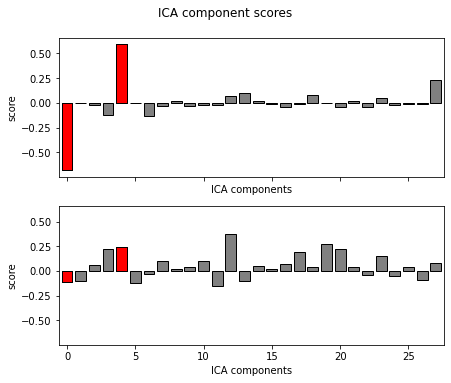

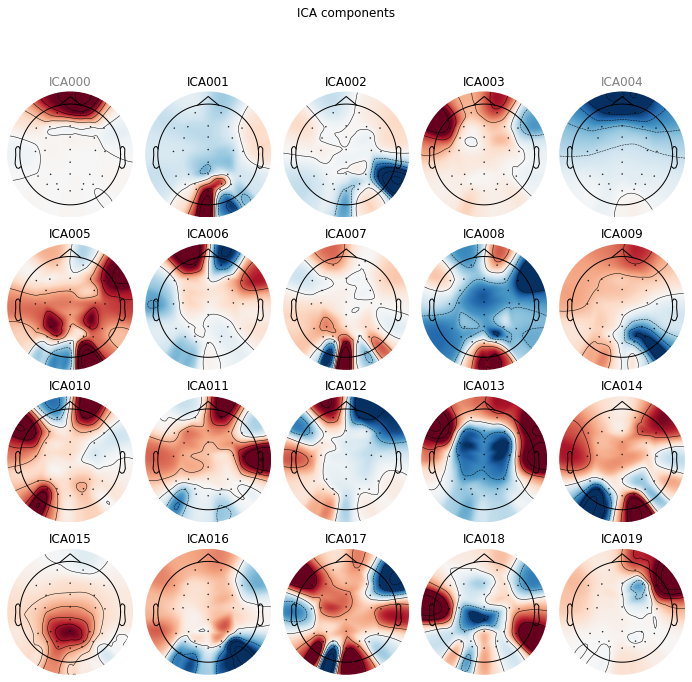

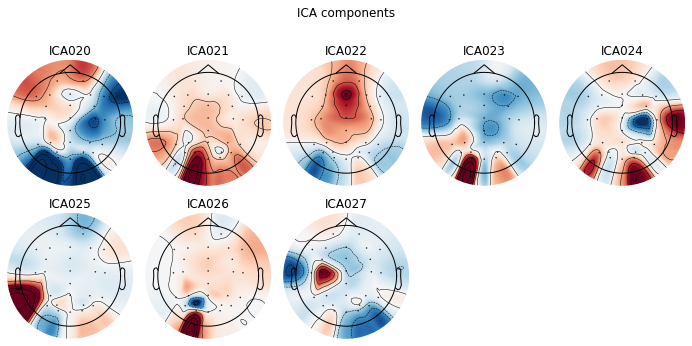

Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=935936
    Range : 0 ... 935935 =      0.000 ...   913.999 secs
Ready.
Using matplotlib as 2D backend.
Opening ica-browser...


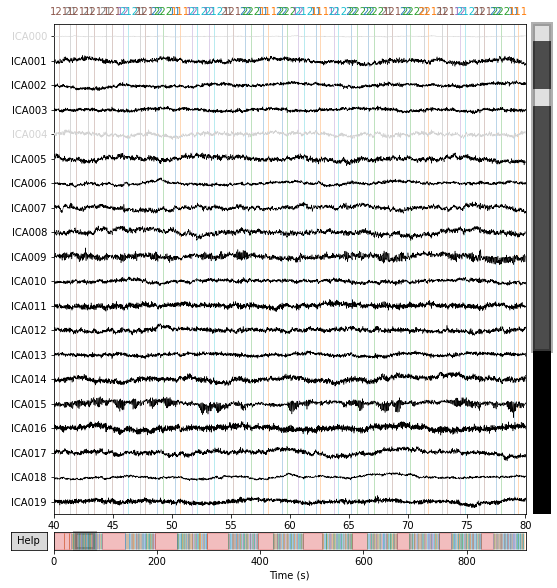

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/1_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/1_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/1_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/2/2_ERN.fdt
Reading 0 ... 900095  =      0.000 ...   878.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=900096
    Range : 0 ... 900095 =      0.000 ...   878.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz


/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 33793 samples (33.001 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 291443 of 900096 (32.38%) samples, retaining 608653 (67.62%) samples.
Selecting by number: 28 components
Fitting ICA took 204.3s.
Using EOG channels: VEOG, HEOG
Omitting 291443 of 900096 (32.38%) samples, retaining 608653 (67.62%) samples.
Omitting 291443 of 900096 (32.38%) samples, retaining 608653 (67.62%) samples.
Omitting 291443 of 900096 (32.38%) samples, retaining 608653 (67.62%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz

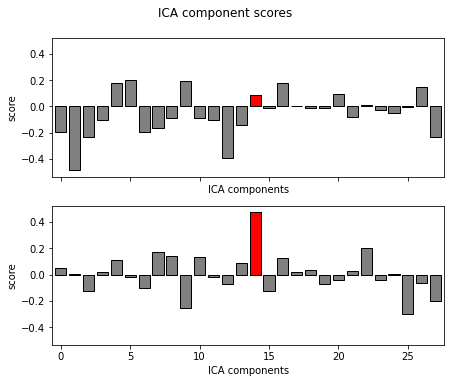

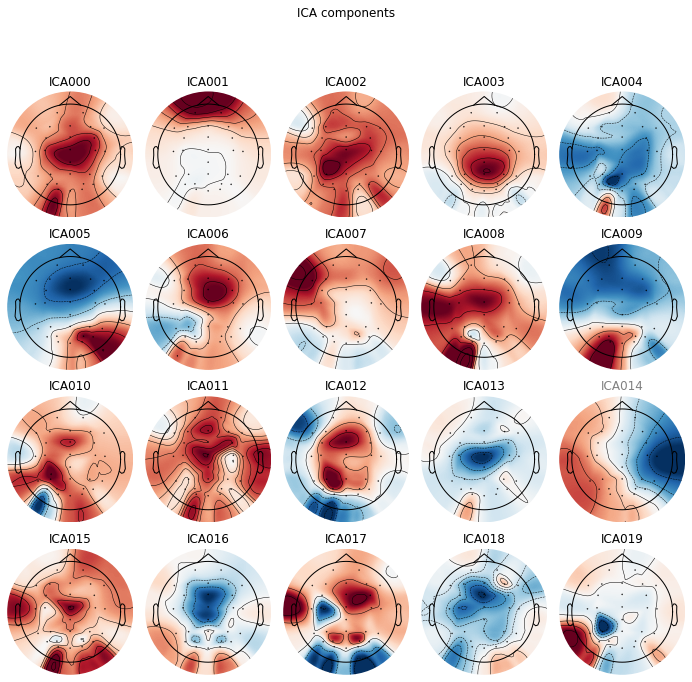

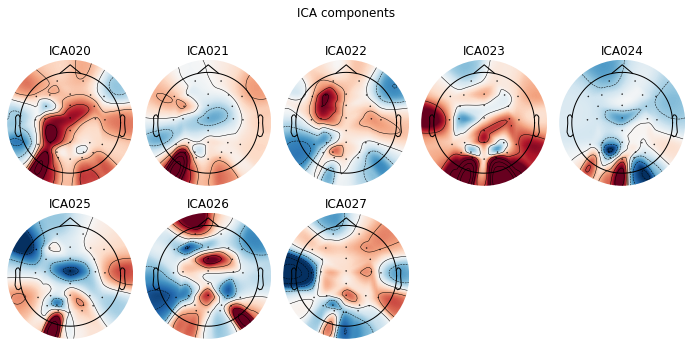

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=900096
    Range : 0 ... 900095 =      0.000 ...   878.999 secs
Ready.
Opening ica-browser...


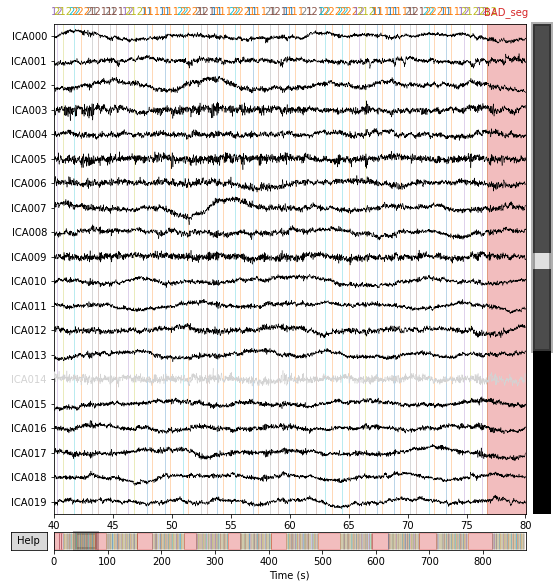

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/2_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/2_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/2_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/3/3_ERN.fdt
Reading 0 ... 792575  =      0.000 ...   773.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=792576
    Range : 0 ... 792575 =      0.000 ...   773.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff freque

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 188838 of 792576 (23.83%) samples, retaining 603738 (76.17%) samples.
Selecting by number: 28 components
Fitting ICA took 114.5s.
Using EOG channels: VEOG, HEOG
Omitting 188838 of 792576 (23.83%) samples, retaining 603738 (76.17%) samples.
Omitting 188838 of 792576 (23.83%) samples, retaining 603738 (76.17%) samples.
Omitting 188838 of 792576 (23.83%) samples, retaining 603738 (76.17%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

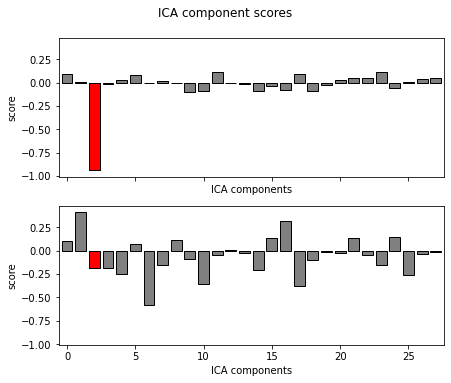

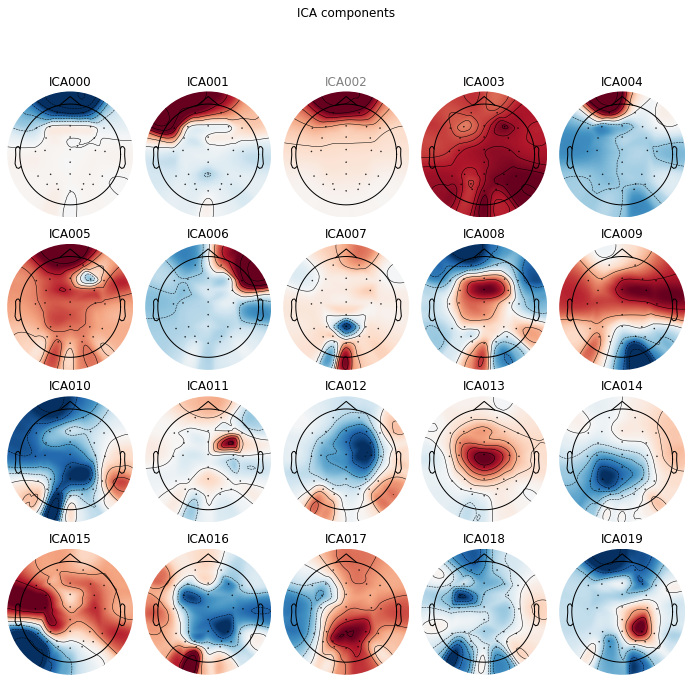

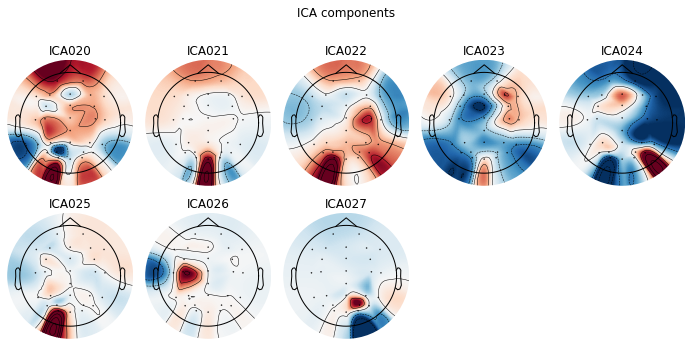

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=792576
    Range : 0 ... 792575 =      0.000 ...   773.999 secs
Ready.
Opening ica-browser...


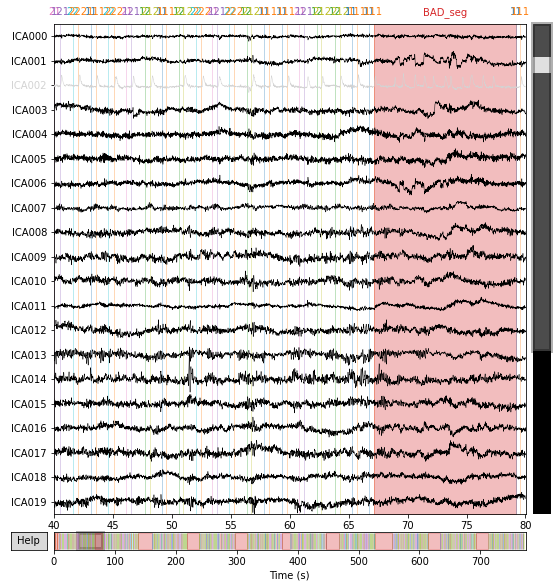

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/3_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/3_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/3_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/4/4_ERN.fdt
Reading 0 ... 1023999  =      0.000 ...   999.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=1024000
    Range : 0 ... 1023999 =      0.000 ...   999.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 418029 of 1024000 (40.82%) samples, retaining 605971 (59.18%) samples.
Selecting by number: 28 components
Fitting ICA took 53.0s.
Using EOG channels: VEOG, HEOG
Omitting 418029 of 1024000 (40.82%) samples, retaining 605971 (59.18%) samples.
Omitting 418029 of 1024000 (40.82%) samples, retaining 605971 (59.18%) samples.
Omitting 418029 of 1024000 (40.82%) samples, retaining 605971 (59.18%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 s

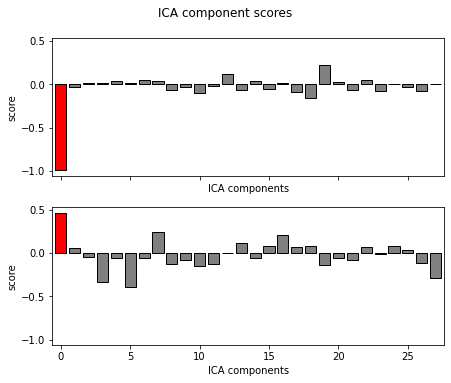

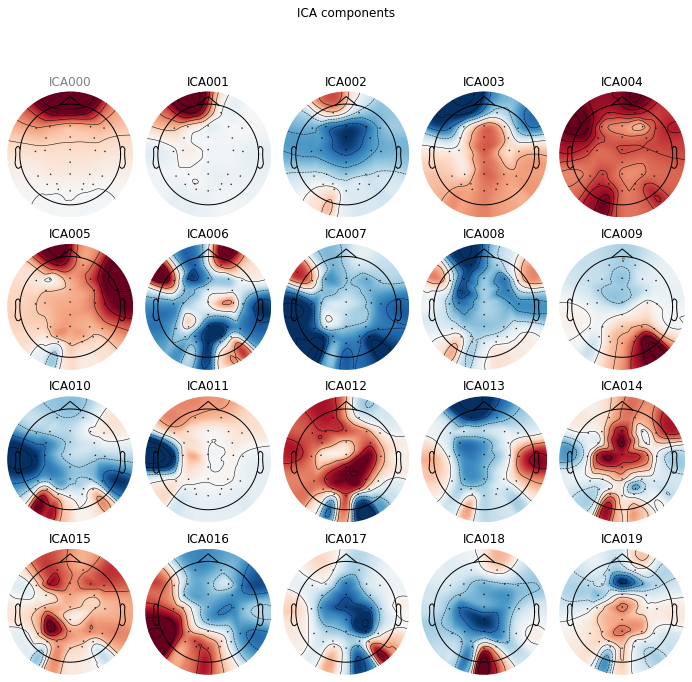

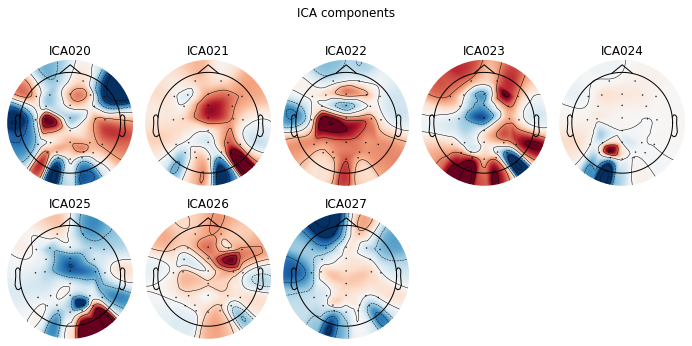

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=1024000
    Range : 0 ... 1023999 =      0.000 ...   999.999 secs
Ready.
Opening ica-browser...


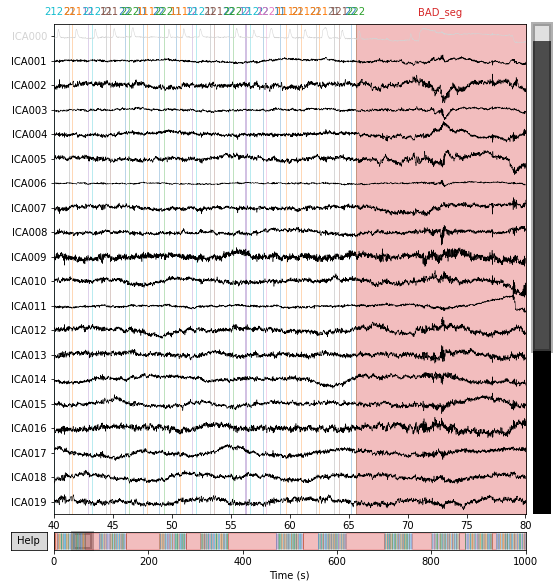

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/4_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/4_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/4_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/5/5_ERN.fdt
Reading 0 ... 800767  =      0.000 ...   781.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=800768
    Range : 0 ... 800767 =      0.000 ...   781.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff freque

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 191963 of 800768 (23.97%) samples, retaining 608805 (76.03%) samples.
Selecting by number: 28 components
Fitting ICA took 47.5s.
Using EOG channels: VEOG, HEOG
Omitting 191963 of 800768 (23.97%) samples, retaining 608805 (76.03%) samples.
Omitting 191963 of 800768 (23.97%) samples, retaining 608805 (76.03%) samples.
Omitting 191963 of 800768 (23.97%) samples, retaining 608805 (76.03%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


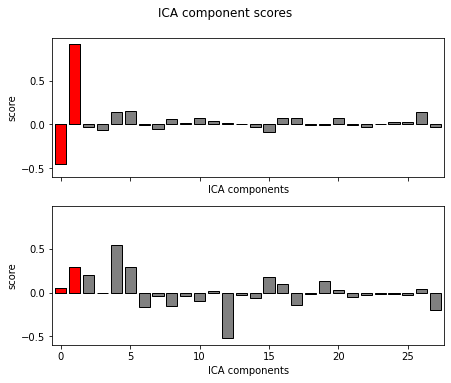

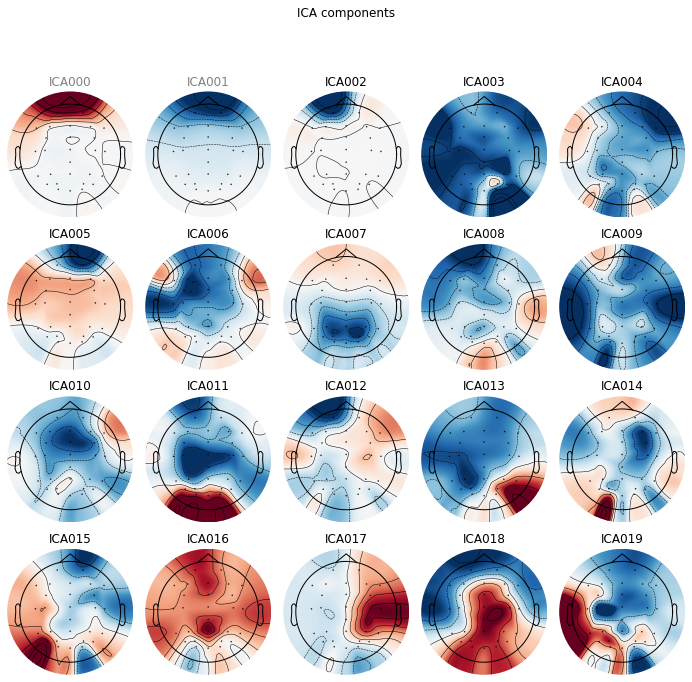

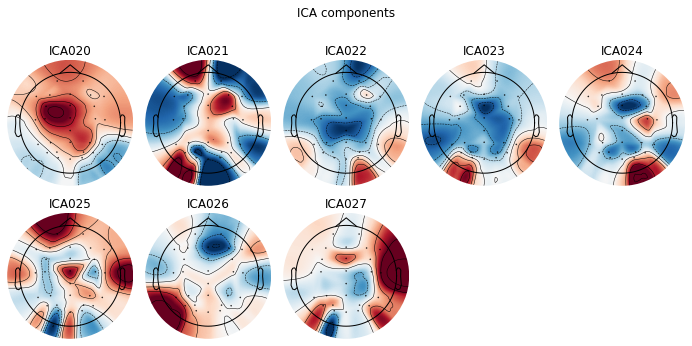

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=800768
    Range : 0 ... 800767 =      0.000 ...   781.999 secs
Ready.
Opening ica-browser...


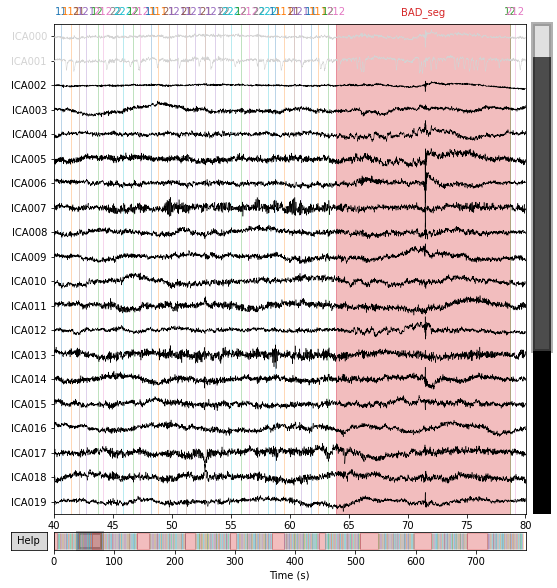

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/5_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/5_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/5_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/6/6_ERN.fdt
Reading 0 ... 669695  =      0.000 ...   653.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=669696
    Range : 0 ... 669695 =      0.000 ...   653.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff freque

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 73275 of 669696 (10.94%) samples, retaining 596421 (89.06%) samples.
Selecting by number: 28 components
Fitting ICA took 58.1s.
Using EOG channels: VEOG, HEOG
Omitting 73275 of 669696 (10.94%) samples, retaining 596421 (89.06%) samples.
Omitting 73275 of 669696 (10.94%) samples, retaining 596421 (89.06%) samples.
Omitting 73275 of 669696 (10.94%) samples, retaining 596421 (89.06%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

...

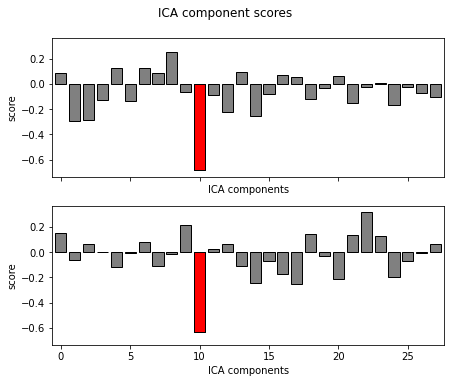

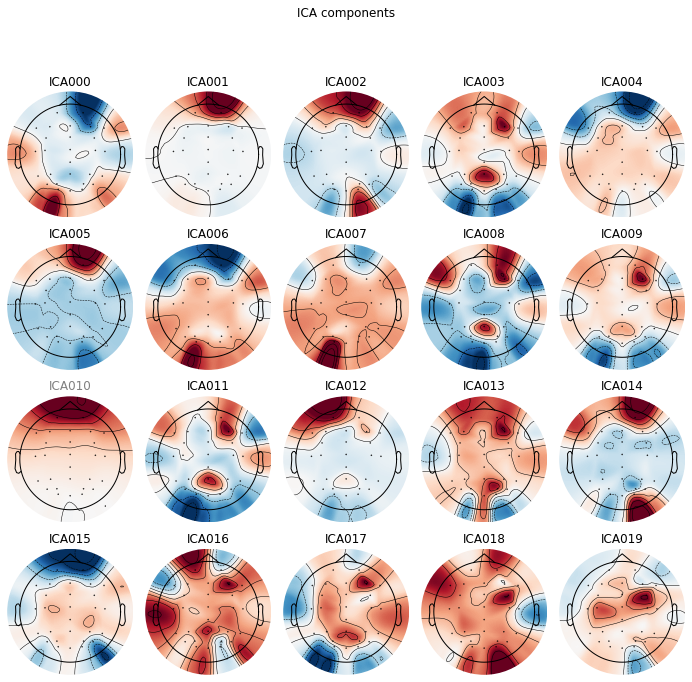

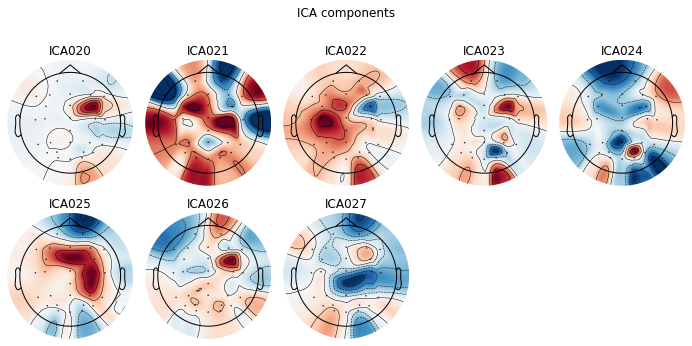

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=669696
    Range : 0 ... 669695 =      0.000 ...   653.999 secs
Ready.
Opening ica-browser...


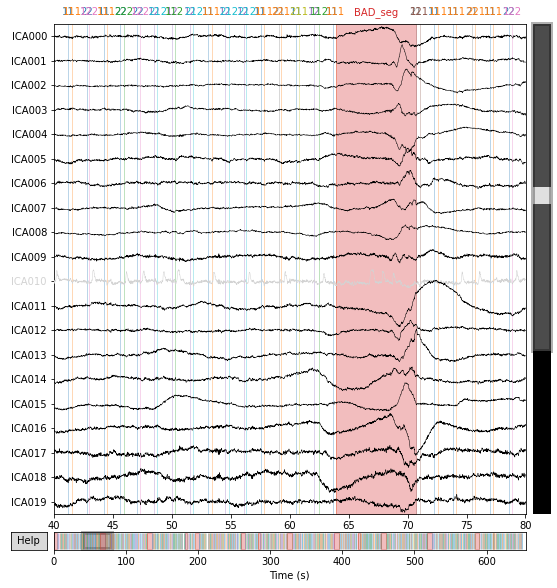

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/6_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/6_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/6_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/7/7_ERN.fdt
Reading 0 ... 746495  =      0.000 ...   728.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=746496
    Range : 0 ... 746495 =      0.000 ...   728.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff freque

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')



Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 136565 of 746496 (18.29%) samples, retaining 609931 (81.71%) samples.
Selecting by number: 28 components
Fitting ICA took 80.3s.
Using EOG channels: VEOG, HEOG
Omitting 136565 of 746496 (18.29%) samples, retaining 609931 (81.71%) samples.
Omitting 136565 of 746496 (18.29%) samples, retaining 609931 (81.71%) samples.
Omitting 136565 of 746496 (18.29%) samples, retaining 609931 (81.71%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

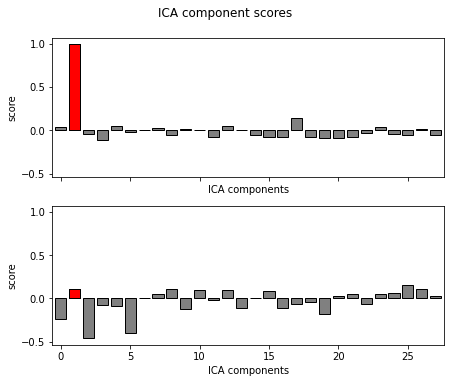

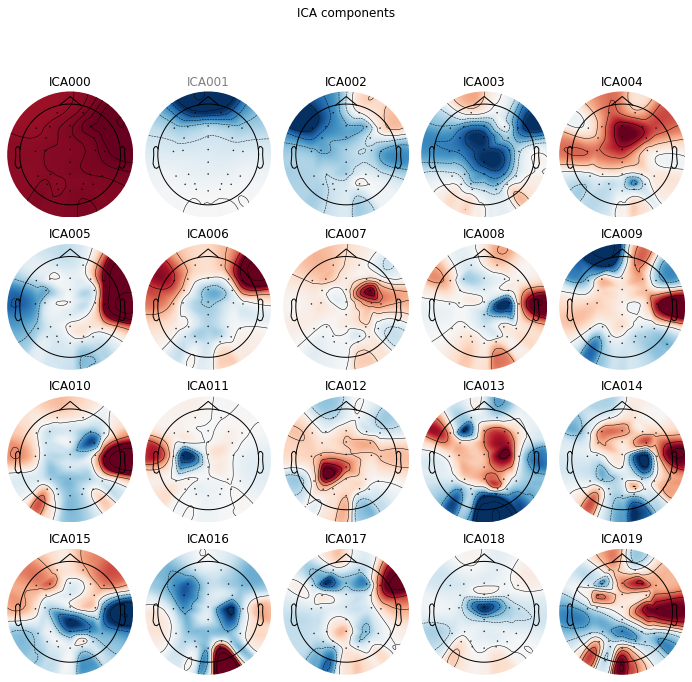

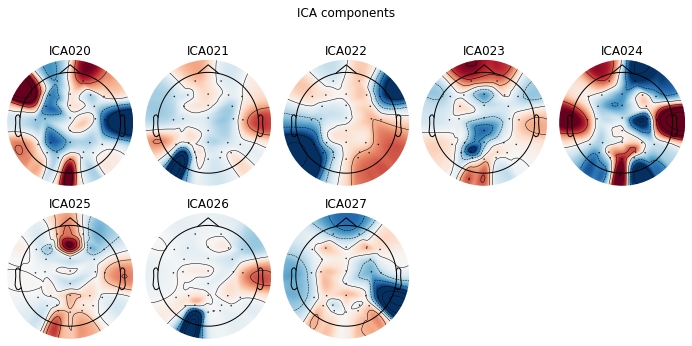

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=746496
    Range : 0 ... 746495 =      0.000 ...   728.999 secs
Ready.
Opening ica-browser...


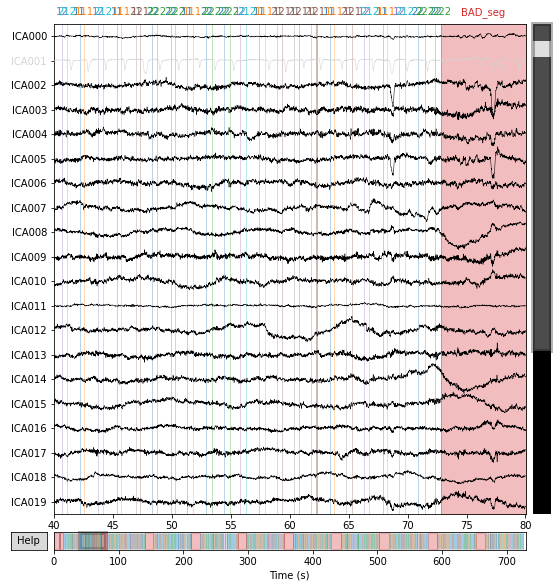

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/7_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/7_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/7_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/8/8_ERN.fdt
Reading 0 ... 1074175  =      0.000 ...  1048.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=1074176
    Range : 0 ... 1074175 =      0.000 ...  1048.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 469291 of 1074176 (43.69%) samples, retaining 604885 (56.31%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 712.6s.
Using EOG channels: VEOG, HEOG
Omitting 469291 of 1074176 (43.69%) samples, retaining 604885 (56.31%) samples.
Omitting 469291 of 1074176 (43.69%) samples, retaining 604885 (56.31%) samples.
Omitting 469291 of 1074176 (43.69%) samples, retaining 604885 (56.31%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:

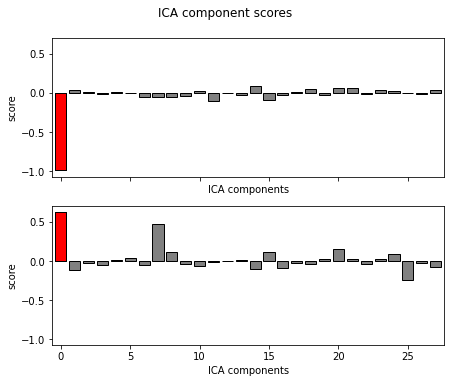

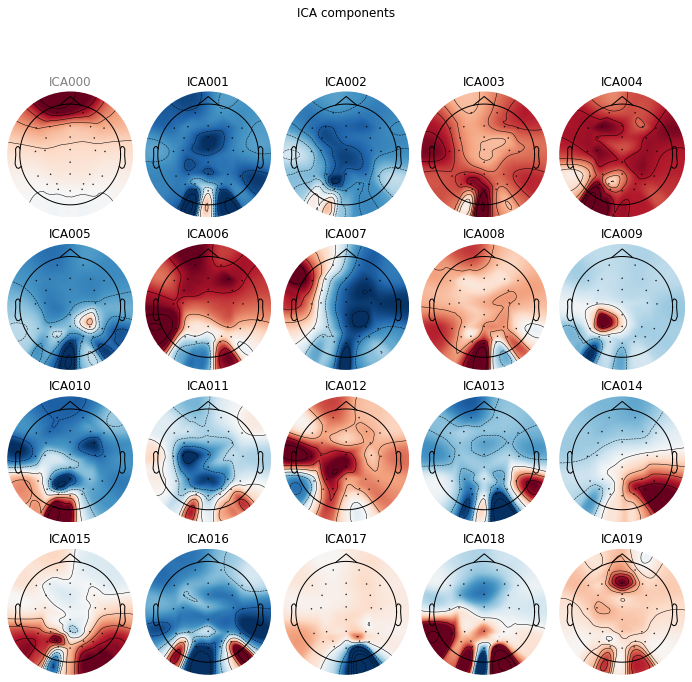

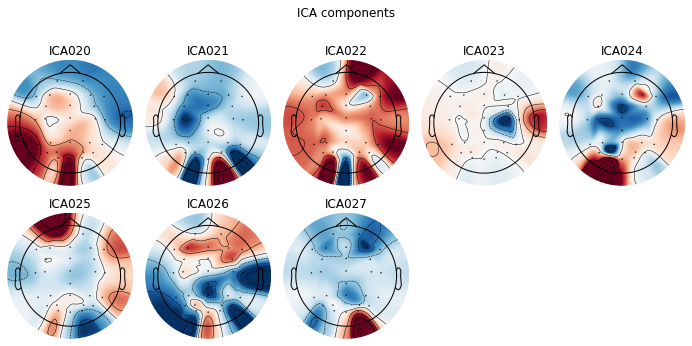

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=1074176
    Range : 0 ... 1074175 =      0.000 ...  1048.999 secs
Ready.
Opening ica-browser...


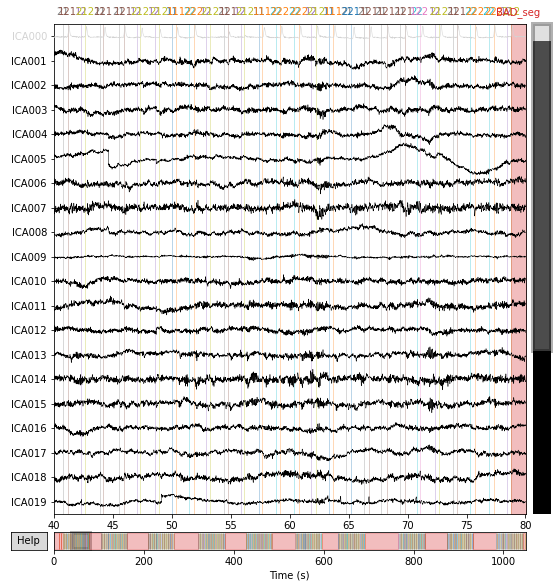

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/8_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/8_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/8_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/9/9_ERN.fdt
Reading 0 ... 698367  =      0.000 ...   681.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=698368
    Range : 0 ... 698367 =      0.000 ...   681.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff freque

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 91104 of 698368 (13.05%) samples, retaining 607264 (86.95%) samples.
Selecting by number: 28 components
Fitting ICA took 119.0s.
Using EOG channels: VEOG, HEOG
Omitting 91104 of 698368 (13.05%) samples, retaining 607264 (86.95%) samples.
Omitting 91104 of 698368 (13.05%) samples, retaining 607264 (86.95%) samples.
Omitting 91104 of 698368 (13.05%) samples, retaining 607264 (86.95%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

..

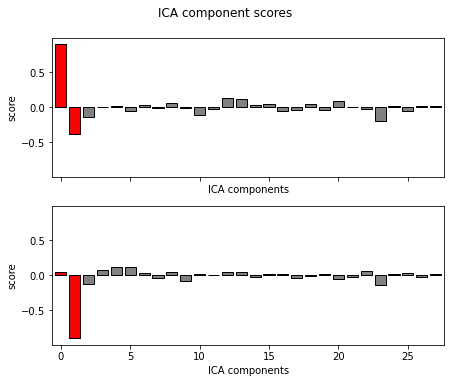

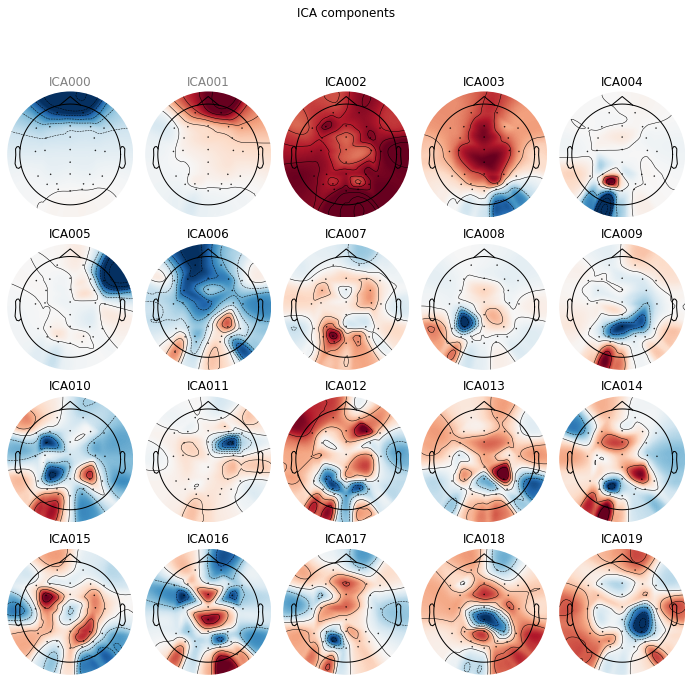

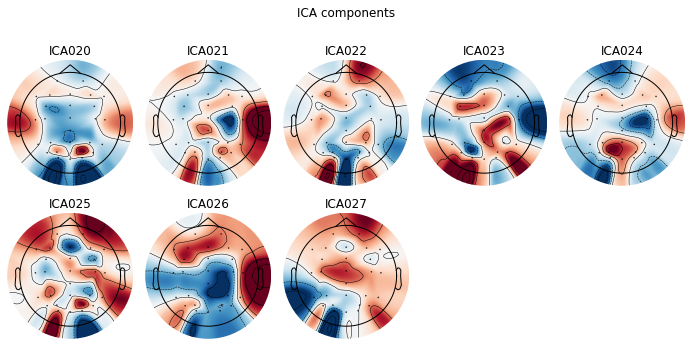

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=698368
    Range : 0 ... 698367 =      0.000 ...   681.999 secs
Ready.
Opening ica-browser...


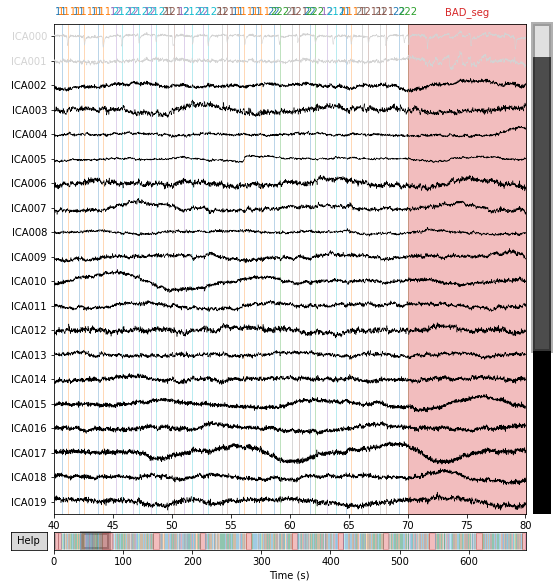

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/9_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/9_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/9_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/10/10_ERN.fdt
Reading 0 ... 770047  =      0.000 ...   751.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=770048
    Range : 0 ... 770047 =      0.000 ...   751.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff freq

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 113895 of 770048 (14.79%) samples, retaining 656153 (85.21%) samples.
Selecting by number: 28 components
Fitting ICA took 26.9s.
Using EOG channels: VEOG, HEOG
Omitting 113895 of 770048 (14.79%) samples, retaining 656153 (85.21%) samples.
Omitting 113895 of 770048 (14.79%) samples, retaining 656153 (85.21%) samples.
Omitting 113895 of 770048 (14.79%) samples, retaining 656153 (85.21%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


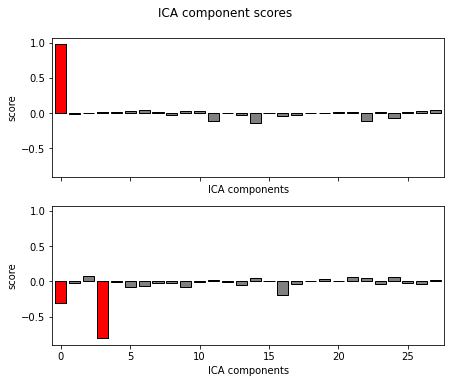

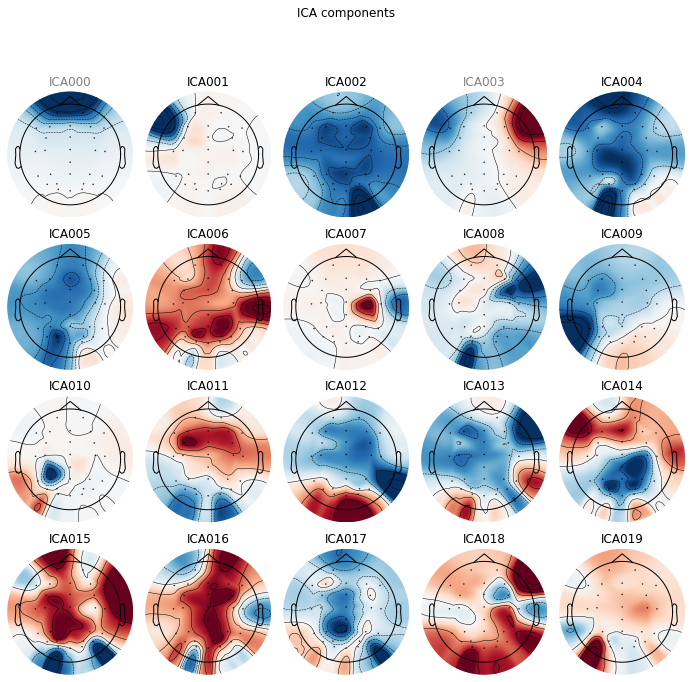

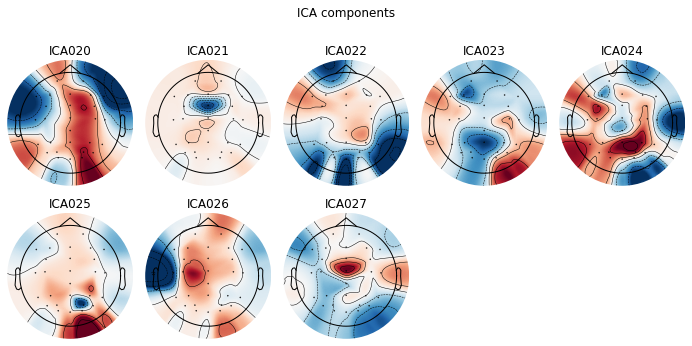

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=770048
    Range : 0 ... 770047 =      0.000 ...   751.999 secs
Ready.
Opening ica-browser...


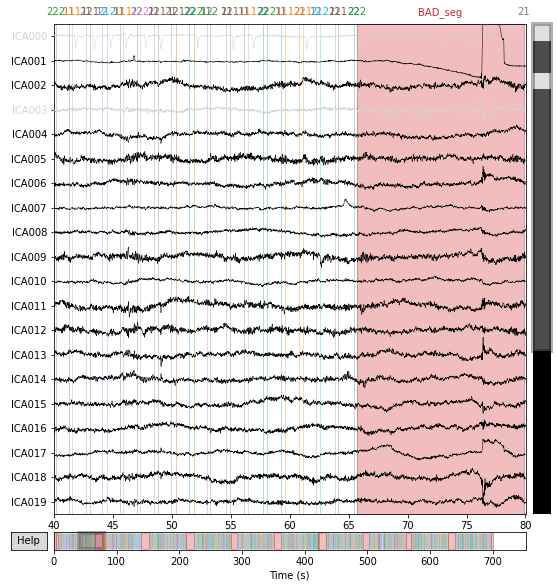

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/10_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/10_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/10_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/11/11_ERN.fdt
Reading 0 ... 741375  =      0.000 ...   723.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=741376
    Range : 0 ... 741375 =      0.000 ...   723.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 131013 of 741376 (17.67%) samples, retaining 610363 (82.33%) samples.
Selecting by number: 28 components
Fitting ICA took 58.8s.
Using EOG channels: VEOG, HEOG
Omitting 131013 of 741376 (17.67%) samples, retaining 610363 (82.33%) samples.
Omitting 131013 of 741376 (17.67%) samples, retaining 610363 (82.33%) samples.
Omitting 131013 of 741376 (17.67%) samples, retaining 610363 (82.33%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


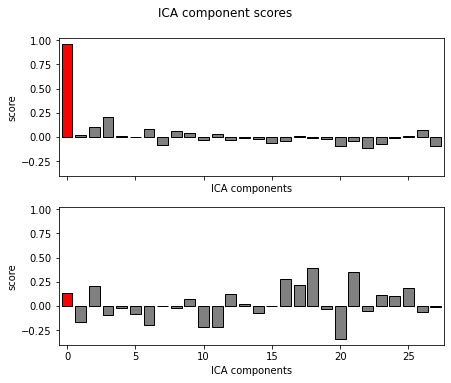

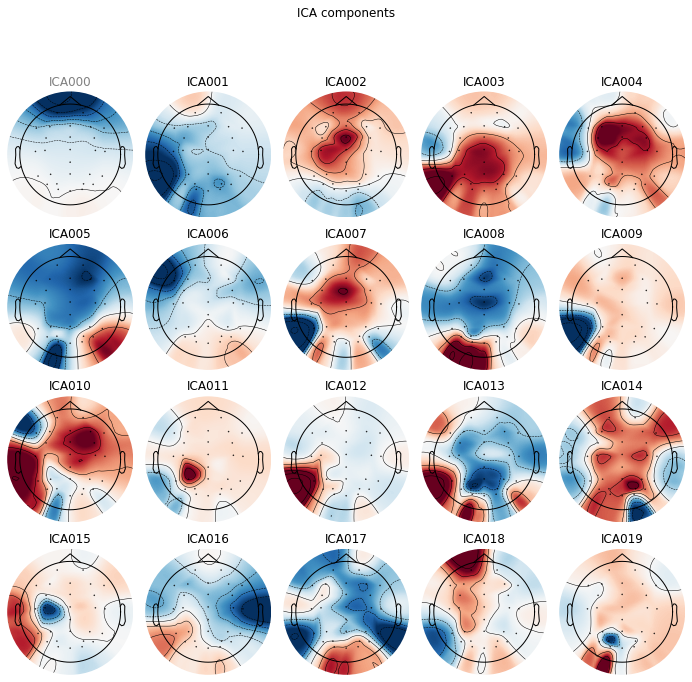

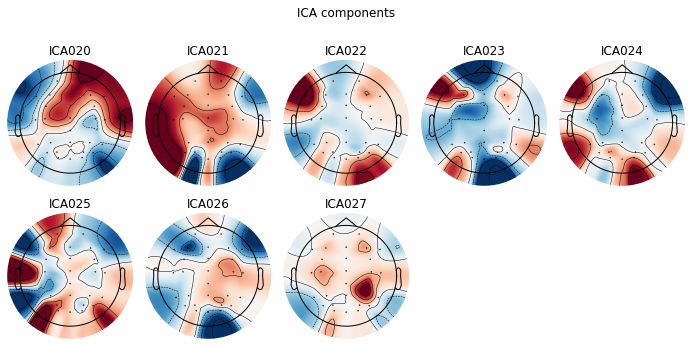

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=741376
    Range : 0 ... 741375 =      0.000 ...   723.999 secs
Ready.
Opening ica-browser...


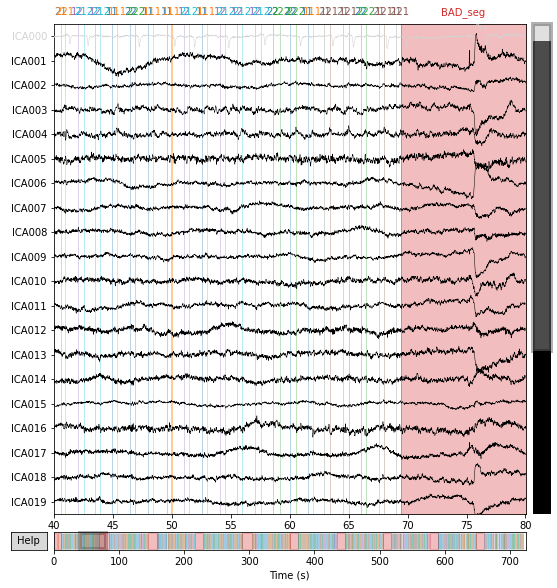

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/11_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/11_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/11_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/12/12_ERN.fdt
Reading 0 ... 693247  =      0.000 ...   676.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=693248
    Range : 0 ... 693247 =      0.000 ...   676.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz


/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 33793 samples (33.001 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 88149 of 693248 (12.72%) samples, retaining 605099 (87.28%) samples.
Selecting by number: 28 components
Fitting ICA took 181.6s.
Using EOG channels: VEOG, HEOG
Omitting 88149 of 693248 (12.72%) samples, retaining 605099 (87.28%) samples.
Omitting 88149 of 693248 (12.72%) samples, retaining 605099 (87.28%) samples.
Omitting 88149 of 693248 (12.72%) samples, retaining 605099 (87.28%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- U

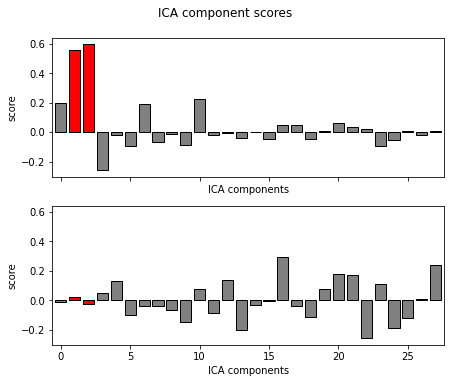

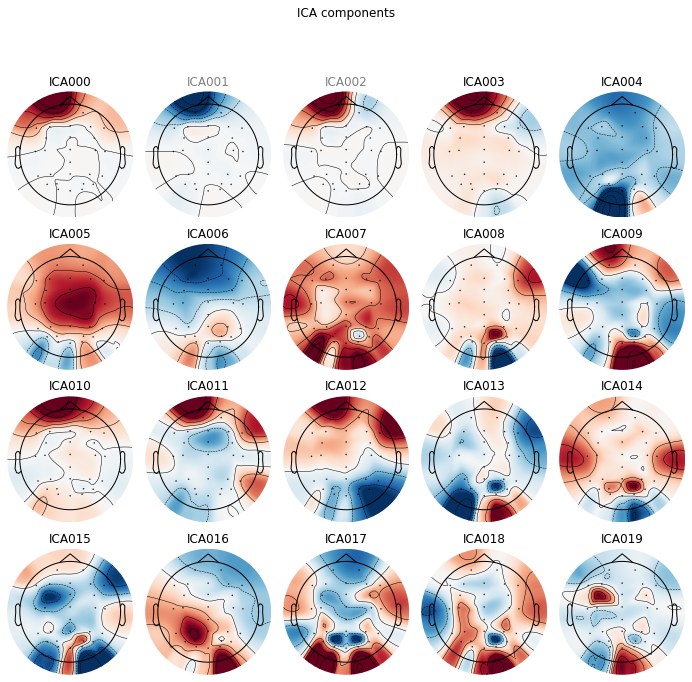

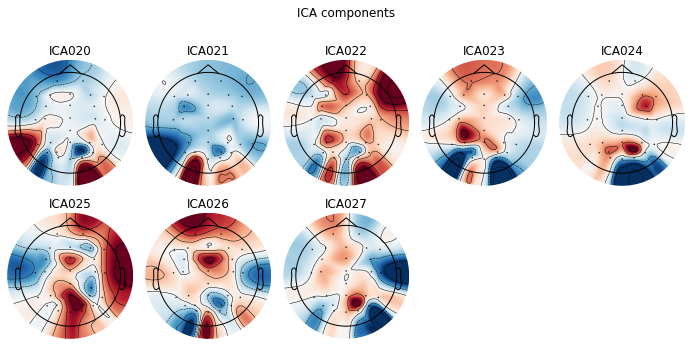

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=693248
    Range : 0 ... 693247 =      0.000 ...   676.999 secs
Ready.
Opening ica-browser...


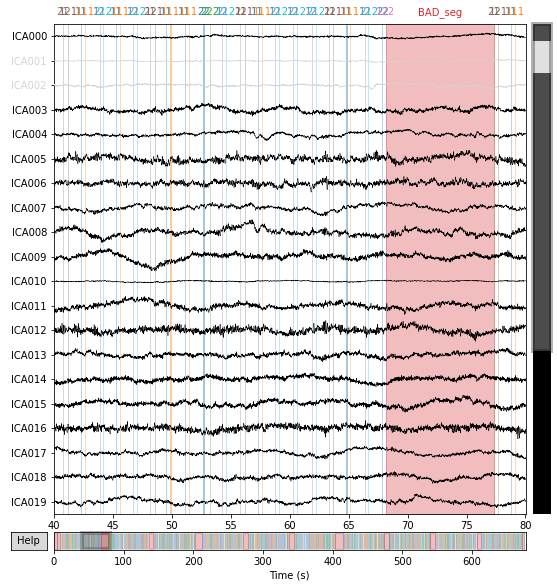

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/12_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/12_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/12_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/13/13_ERN.fdt
Reading 0 ... 745471  =      0.000 ...   727.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=745472
    Range : 0 ... 745471 =      0.000 ...   727.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 137784 of 745472 (18.48%) samples, retaining 607688 (81.52%) samples.
Selecting by number: 28 components
Fitting ICA took 288.2s.
Using EOG channels: VEOG, HEOG
Omitting 137784 of 745472 (18.48%) samples, retaining 607688 (81.52%) samples.
Omitting 137784 of 745472 (18.48%) samples, retaining 607688 (81.52%) samples.
Omitting 137784 of 745472 (18.48%) samples, retaining 607688 (81.52%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

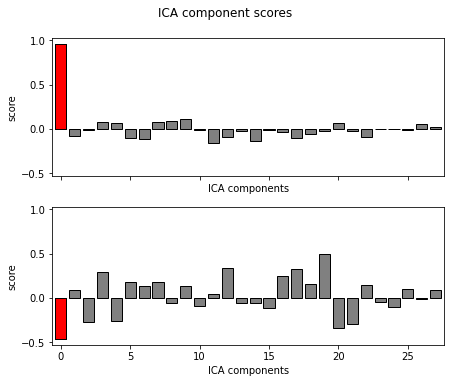

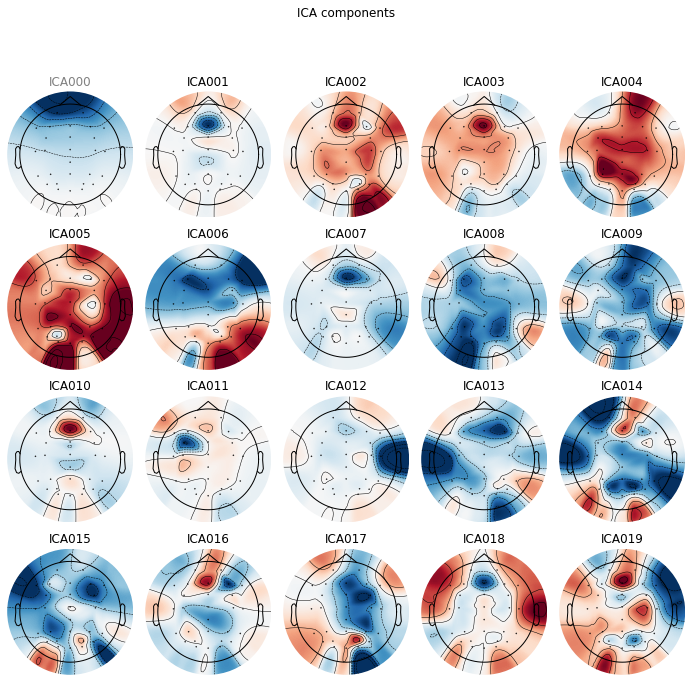

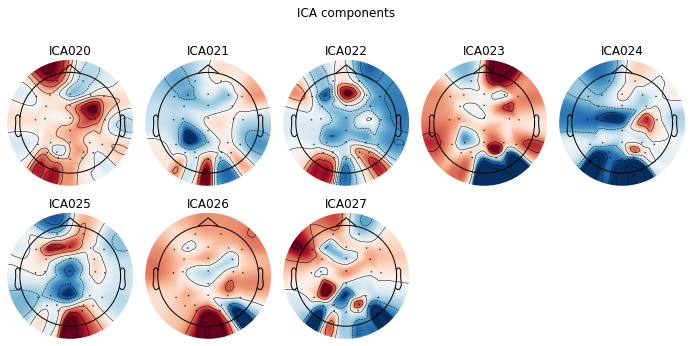

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=745472
    Range : 0 ... 745471 =      0.000 ...   727.999 secs
Ready.
Opening ica-browser...


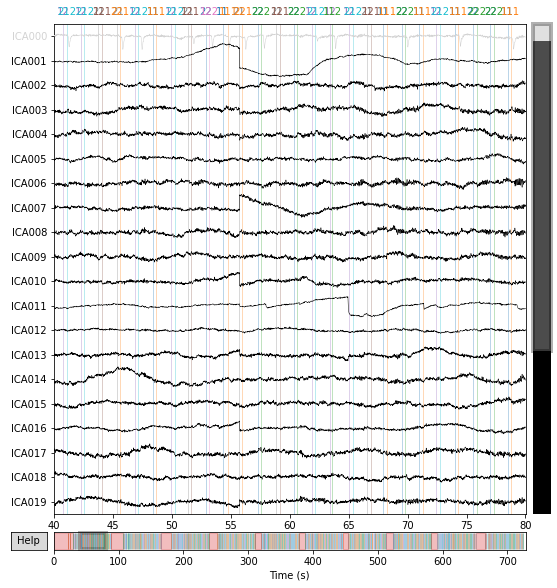

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/13_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/13_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/13_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/14/14_ERN.fdt
Reading 0 ... 696319  =      0.000 ...   679.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=696320
    Range : 0 ... 696319 =      0.000 ...   679.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 87833 of 696320 (12.61%) samples, retaining 608487 (87.39%) samples.
Selecting by number: 28 components
Fitting ICA took 114.9s.
Using EOG channels: VEOG, HEOG
Omitting 87833 of 696320 (12.61%) samples, retaining 608487 (87.39%) samples.
Omitting 87833 of 696320 (12.61%) samples, retaining 608487 (87.39%) samples.
Omitting 87833 of 696320 (12.61%) samples, retaining 608487 (87.39%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

..

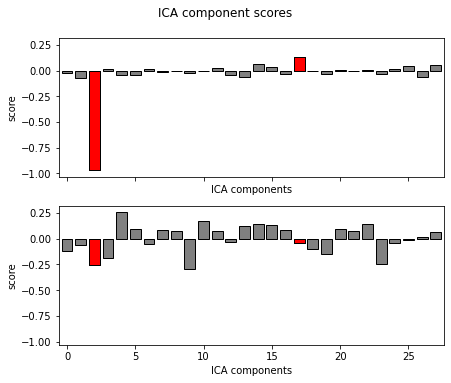

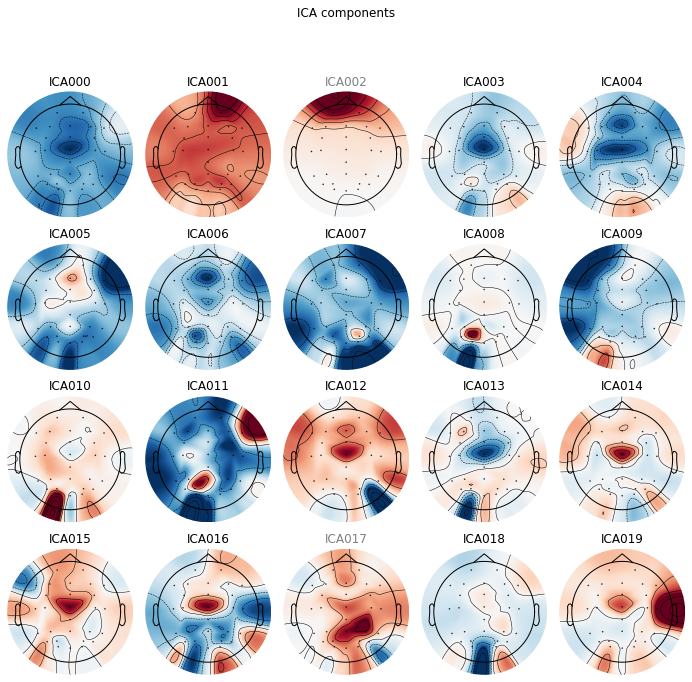

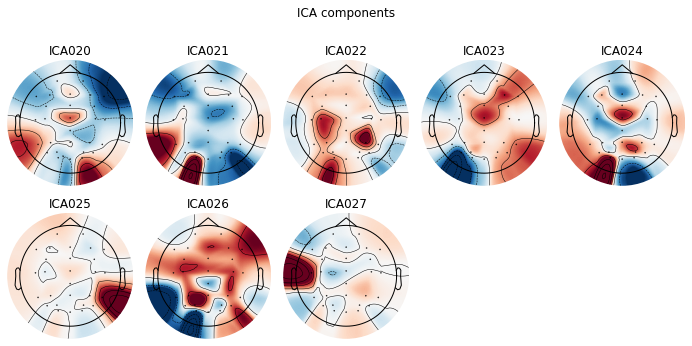

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=696320
    Range : 0 ... 696319 =      0.000 ...   679.999 secs
Ready.
Opening ica-browser...


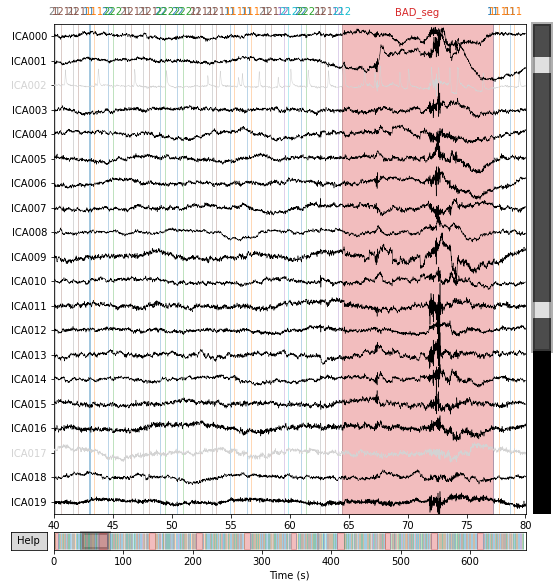

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/14_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/14_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/14_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/15/15_ERN.fdt
Reading 0 ... 746495  =      0.000 ...   728.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=746496
    Range : 0 ... 746495 =      0.000 ...   728.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 136514 of 746496 (18.29%) samples, retaining 609982 (81.71%) samples.
Selecting by number: 28 components
Fitting ICA took 68.1s.
Using EOG channels: VEOG, HEOG
Omitting 136514 of 746496 (18.29%) samples, retaining 609982 (81.71%) samples.
Omitting 136514 of 746496 (18.29%) samples, retaining 609982 (81.71%) samples.
Omitting 136514 of 746496 (18.29%) samples, retaining 609982 (81.71%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


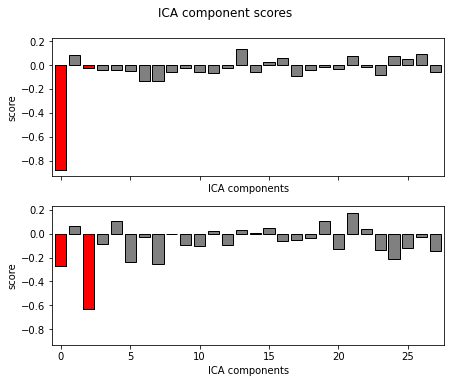

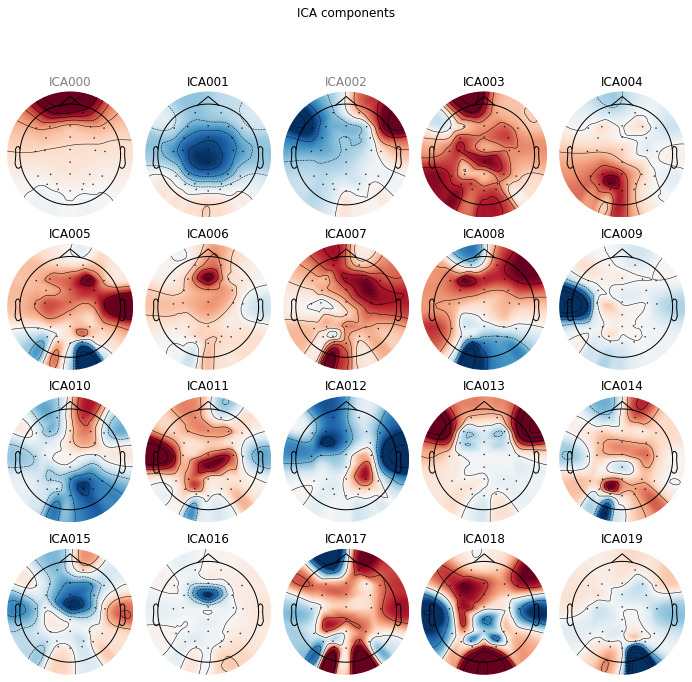

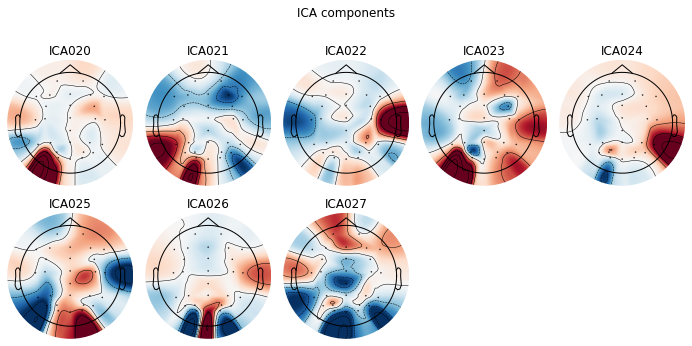

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=746496
    Range : 0 ... 746495 =      0.000 ...   728.999 secs
Ready.
Opening ica-browser...


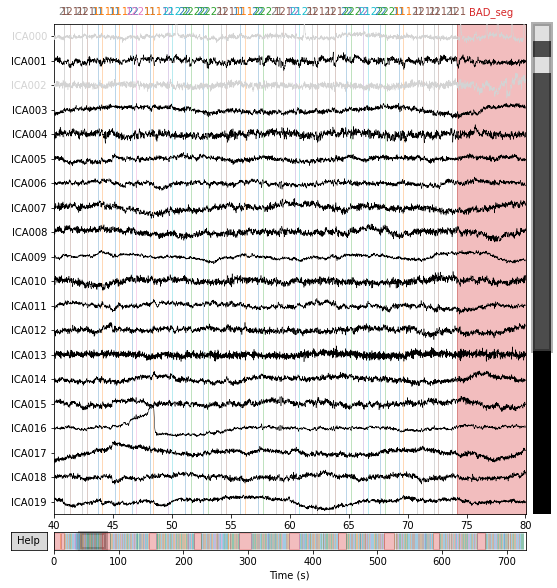

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/15_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/15_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/15_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/16/16_ERN.fdt
Reading 0 ... 796671  =      0.000 ...   777.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=796672
    Range : 0 ... 796671 =      0.000 ...   777.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 188460 of 796672 (23.66%) samples, retaining 608212 (76.34%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 721.4s.
Using EOG channels: VEOG, HEOG
Omitting 188460 of 796672 (23.66%) samples, retaining 608212 (76.34%) samples.
Omitting 188460 of 796672 (23.66%) samples, retaining 608212 (76.34%) samples.
Omitting 188460 of 796672 (23.66%) samples, retaining 608212 (76.34%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

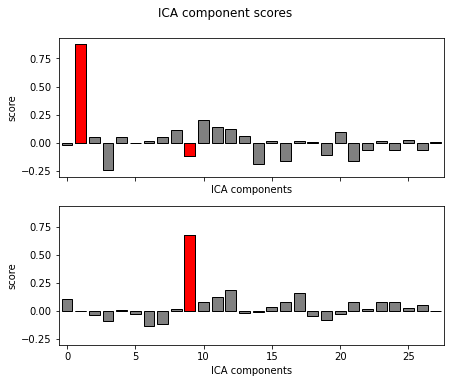

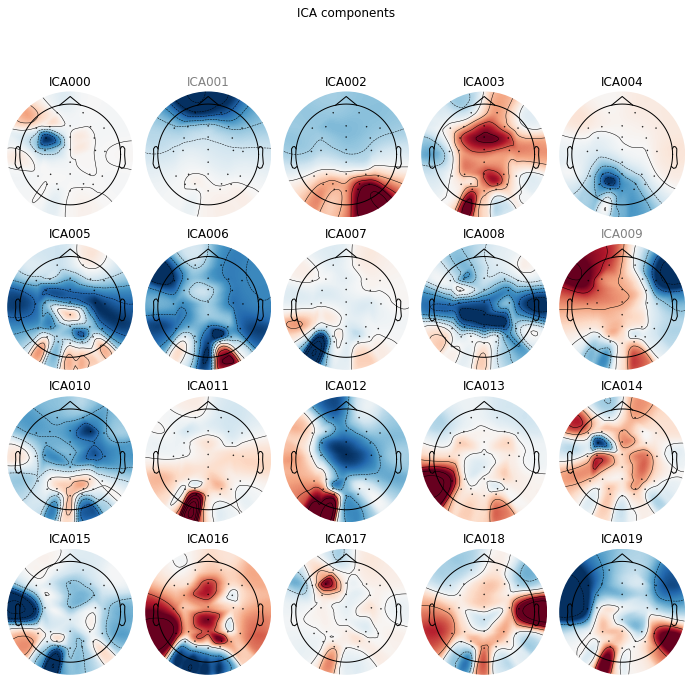

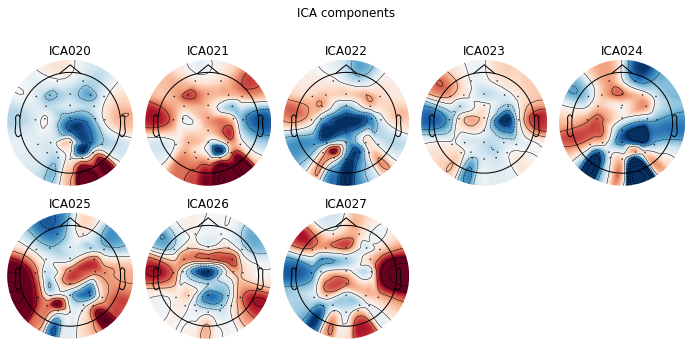

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=796672
    Range : 0 ... 796671 =      0.000 ...   777.999 secs
Ready.
Opening ica-browser...


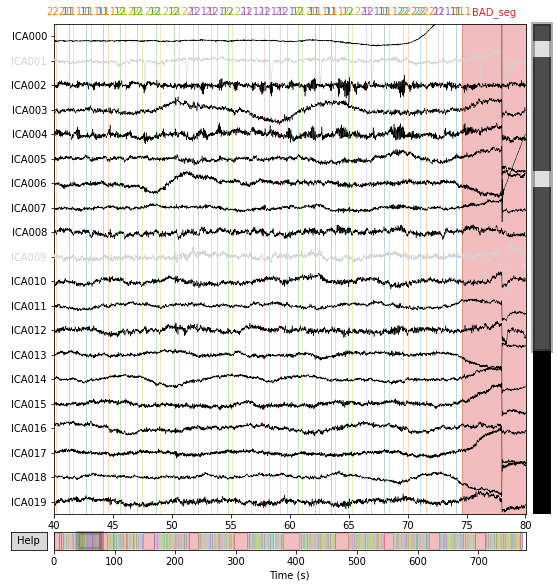

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/16_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/16_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/16_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/17/17_ERN.fdt
Reading 0 ... 782335  =      0.000 ...   763.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=782336
    Range : 0 ... 782335 =      0.000 ...   763.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 173349 of 782336 (22.16%) samples, retaining 608987 (77.84%) samples.
Selecting by number: 28 components
Fitting ICA took 56.0s.
Using EOG channels: VEOG, HEOG
Omitting 173349 of 782336 (22.16%) samples, retaining 608987 (77.84%) samples.
Omitting 173349 of 782336 (22.16%) samples, retaining 608987 (77.84%) samples.
Omitting 173349 of 782336 (22.16%) samples, retaining 608987 (77.84%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


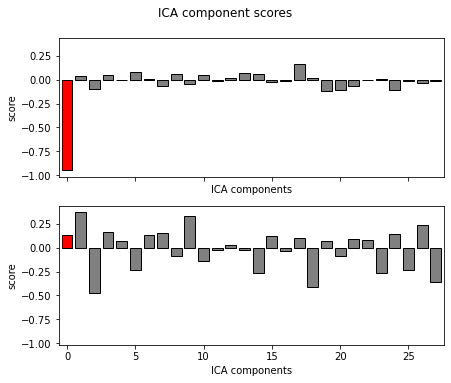

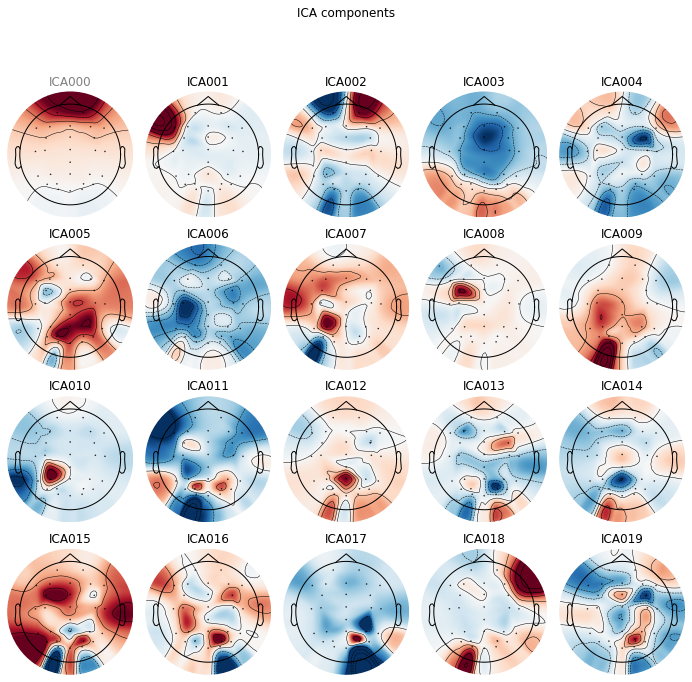

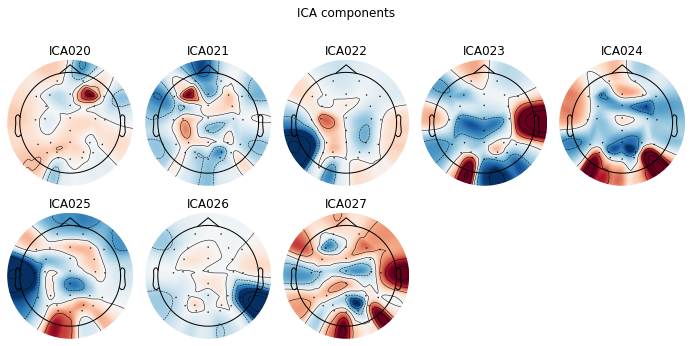

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=782336
    Range : 0 ... 782335 =      0.000 ...   763.999 secs
Ready.
Opening ica-browser...


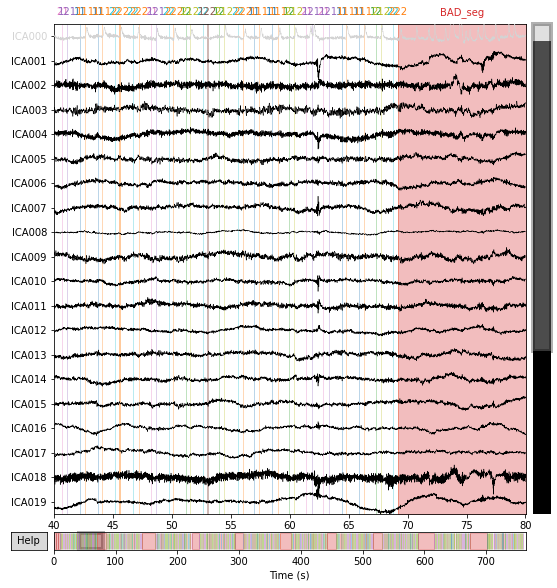

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/17_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/17_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/17_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/18/18_ERN.fdt
Reading 0 ... 749567  =      0.000 ...   731.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=749568
    Range : 0 ... 749567 =      0.000 ...   731.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10


/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 33793 samples (33.001 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 146827 of 749568 (19.59%) samples, retaining 602741 (80.41%) samples.
Selecting by number: 28 components
Fitting ICA took 177.2s.
Using EOG channels: VEOG, HEOG
Omitting 146827 of 749568 (19.59%) samples, retaining 602741 (80.41%) samples.
Omitting 146827 of 749568 (19.59%) samples, retaining 602741 (80.41%) samples.
Omitting 146827 of 749568 (19.59%) samples, retaining 602741 (80.41%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00


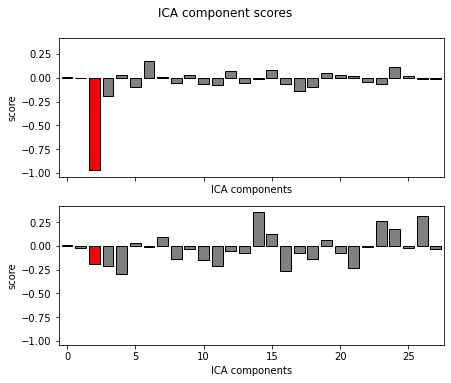

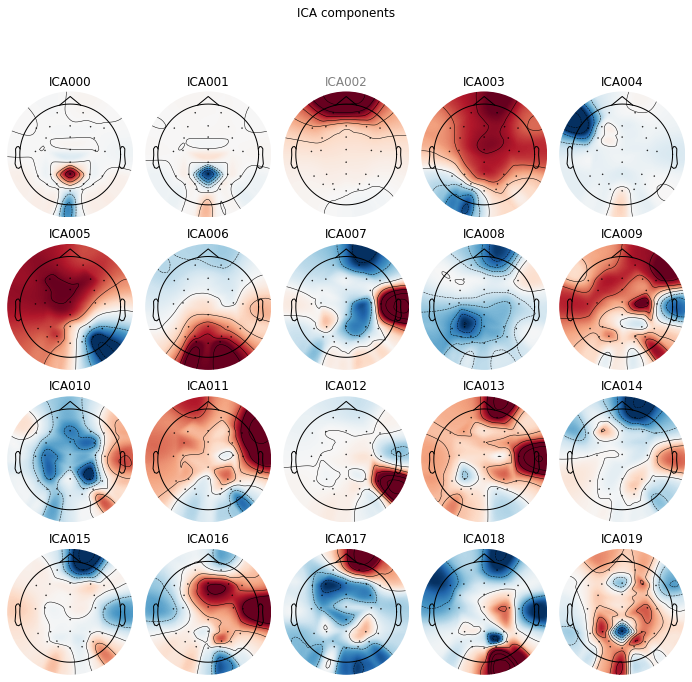

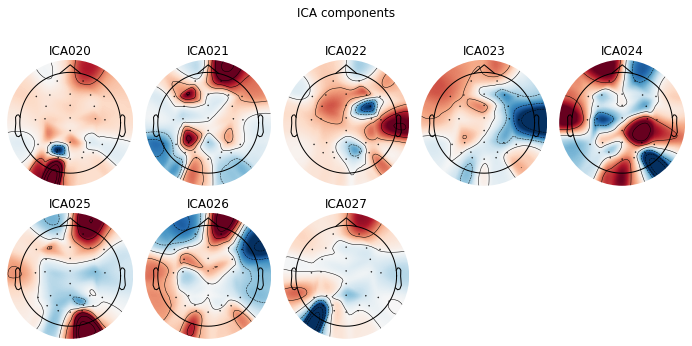

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=749568
    Range : 0 ... 749567 =      0.000 ...   731.999 secs
Ready.
Opening ica-browser...


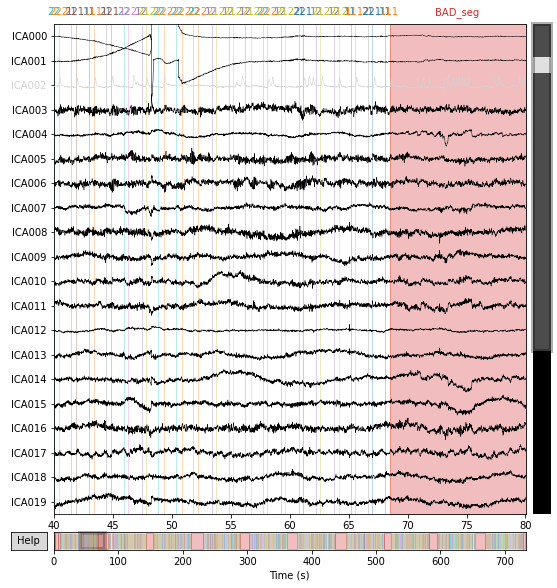

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/18_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/18_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/18_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/19/19_ERN.fdt
Reading 0 ... 747519  =      0.000 ...   729.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=747520
    Range : 0 ... 747519 =      0.000 ...   729.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 139863 of 747520 (18.71%) samples, retaining 607657 (81.29%) samples.
Selecting by number: 28 components
Fitting ICA took 428.3s.
Using EOG channels: VEOG, HEOG
Omitting 139863 of 747520 (18.71%) samples, retaining 607657 (81.29%) samples.
Omitting 139863 of 747520 (18.71%) samples, retaining 607657 (81.29%) samples.
Omitting 139863 of 747520 (18.71%) samples, retaining 607657 (81.29%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

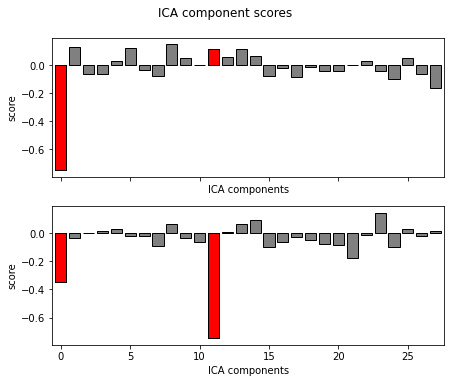

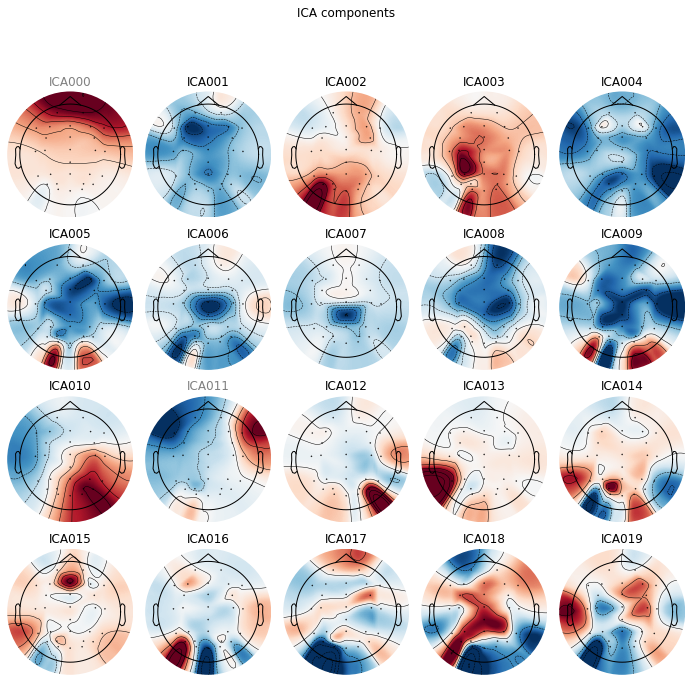

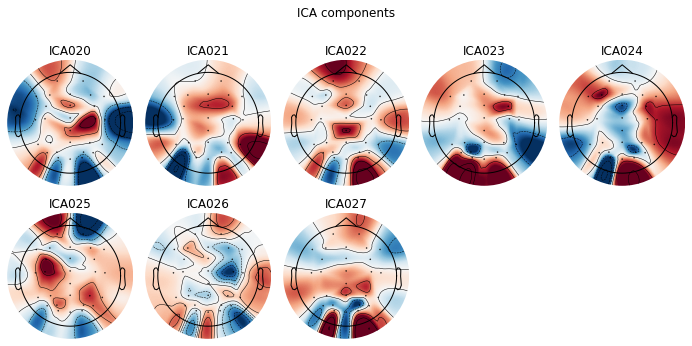

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=747520
    Range : 0 ... 747519 =      0.000 ...   729.999 secs
Ready.
Opening ica-browser...


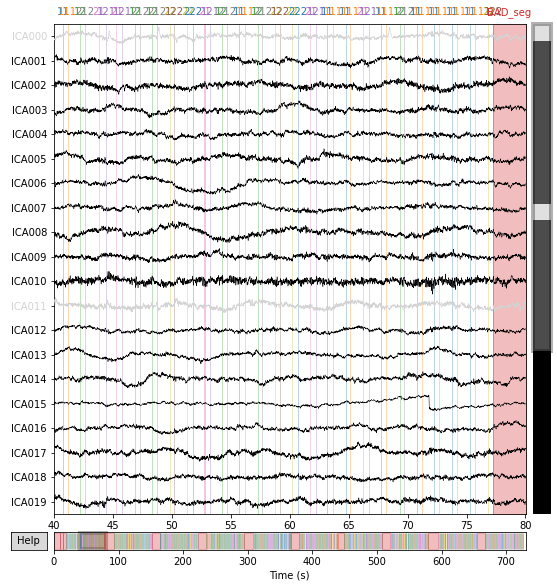

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/19_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/19_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/19_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/20/20_ERN.fdt
Reading 0 ... 770047  =      0.000 ...   751.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=770048
    Range : 0 ... 770047 =      0.000 ...   751.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 161042 of 770048 (20.91%) samples, retaining 609006 (79.09%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 715.7s.
Using EOG channels: VEOG, HEOG
Omitting 161042 of 770048 (20.91%) samples, retaining 609006 (79.09%) samples.
Omitting 161042 of 770048 (20.91%) samples, retaining 609006 (79.09%) samples.
Omitting 161042 of 770048 (20.91%) samples, retaining 609006 (79.09%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

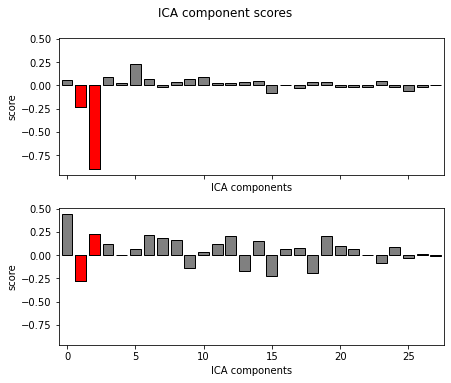

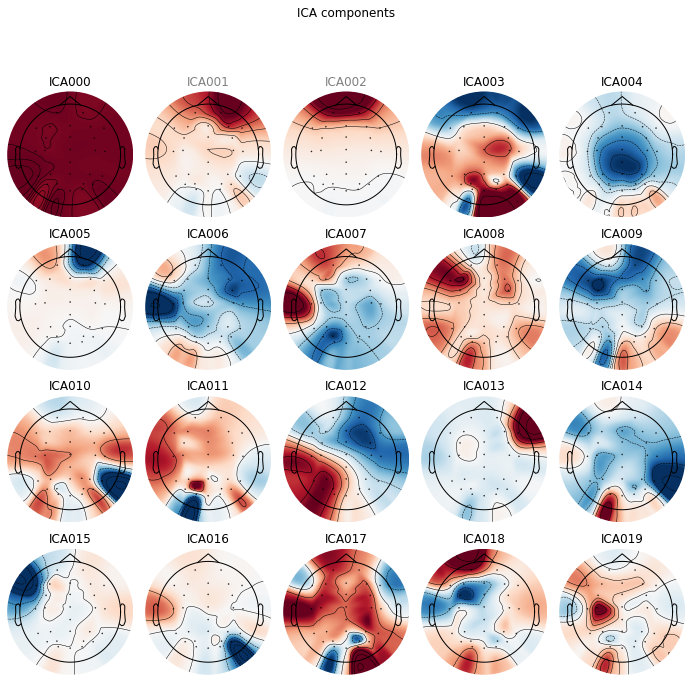

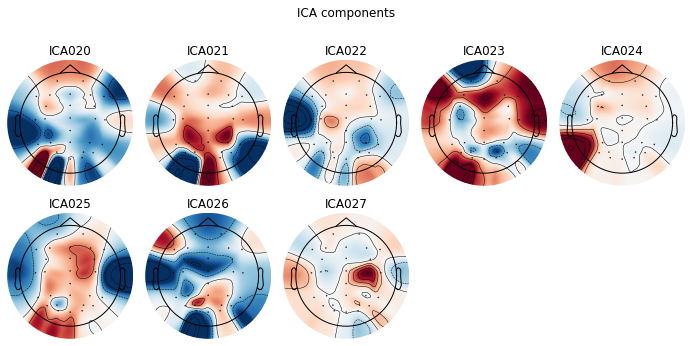

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=770048
    Range : 0 ... 770047 =      0.000 ...   751.999 secs
Ready.
Opening ica-browser...


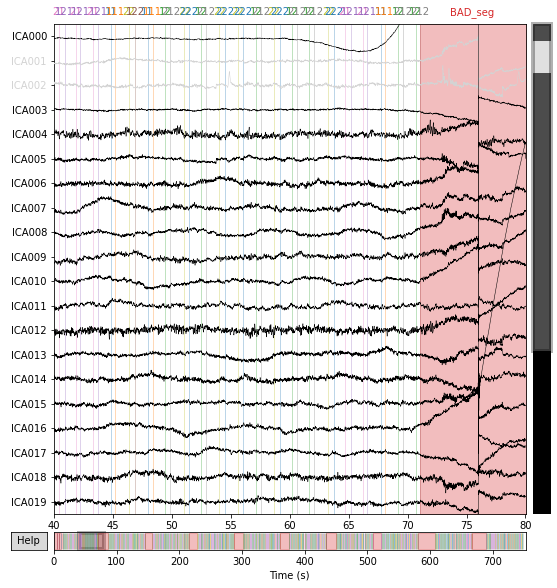

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/20_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/20_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/20_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/21/21_ERN.fdt
Reading 0 ... 800767  =      0.000 ...   781.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=800768
    Range : 0 ... 800767 =      0.000 ...   781.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 191422 of 800768 (23.90%) samples, retaining 609346 (76.10%) samples.
Selecting by number: 28 components
Fitting ICA took 123.7s.
Using EOG channels: VEOG, HEOG
Omitting 191422 of 800768 (23.90%) samples, retaining 609346 (76.10%) samples.
Omitting 191422 of 800768 (23.90%) samples, retaining 609346 (76.10%) samples.
Omitting 191422 of 800768 (23.90%) samples, retaining 609346 (76.10%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

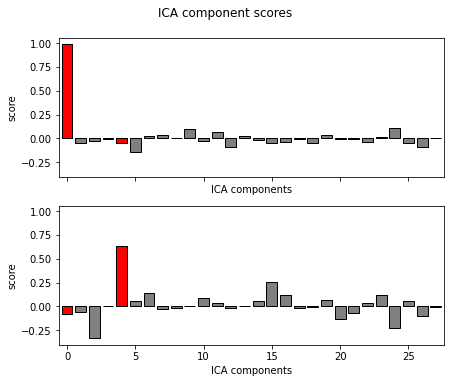

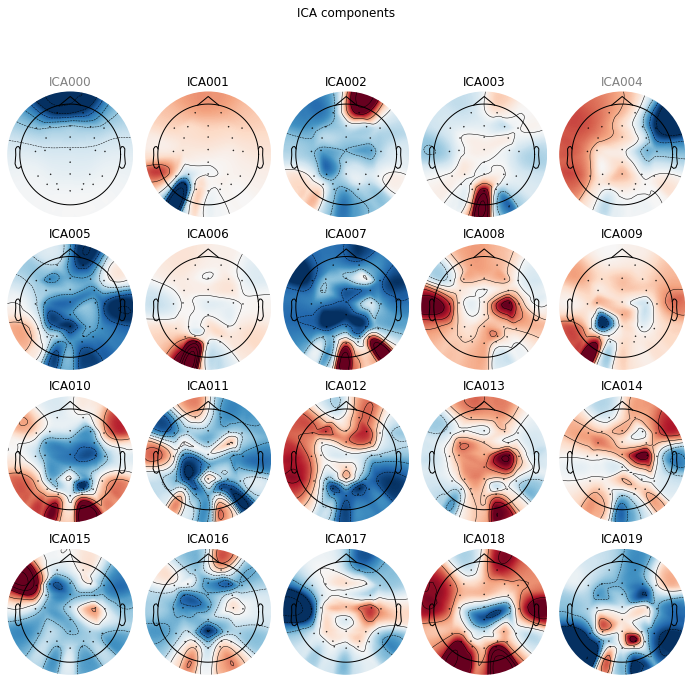

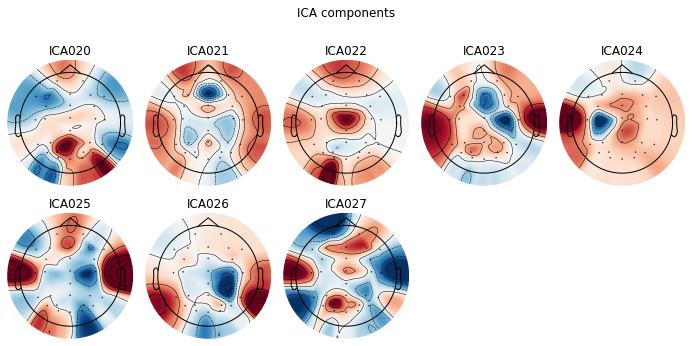

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=800768
    Range : 0 ... 800767 =      0.000 ...   781.999 secs
Ready.
Opening ica-browser...


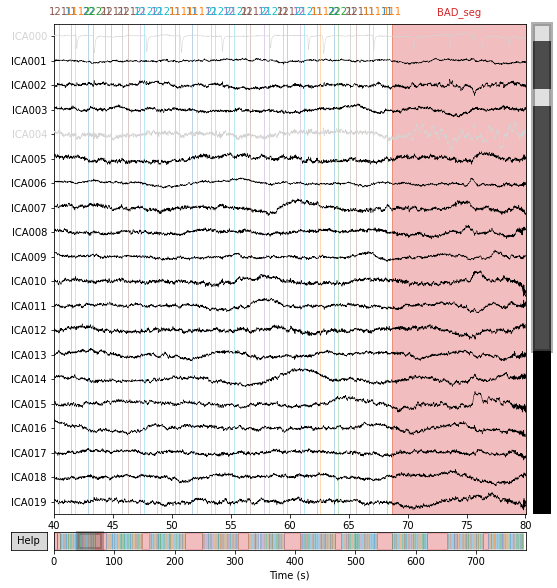

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/21_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/21_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/21_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/22/22_ERN.fdt
Reading 0 ... 742399  =      0.000 ...   724.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=742400
    Range : 0 ... 742399 =      0.000 ...   724.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 136713 of 742400 (18.42%) samples, retaining 605687 (81.58%) samples.
Selecting by number: 28 components
Fitting ICA took 71.7s.
Using EOG channels: VEOG, HEOG
Omitting 136713 of 742400 (18.42%) samples, retaining 605687 (81.58%) samples.
Omitting 136713 of 742400 (18.42%) samples, retaining 605687 (81.58%) samples.
Omitting 136713 of 742400 (18.42%) samples, retaining 605687 (81.58%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


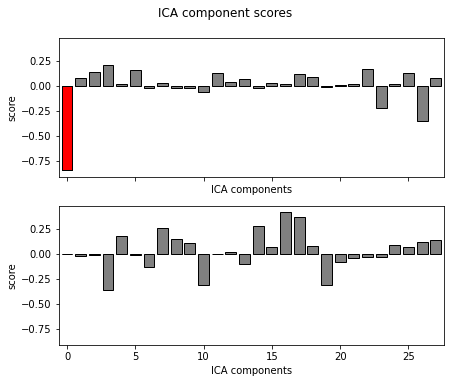

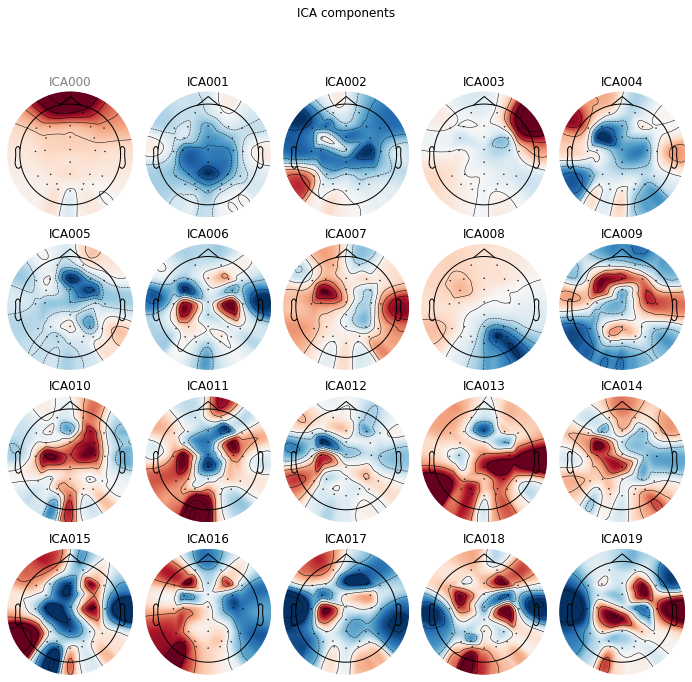

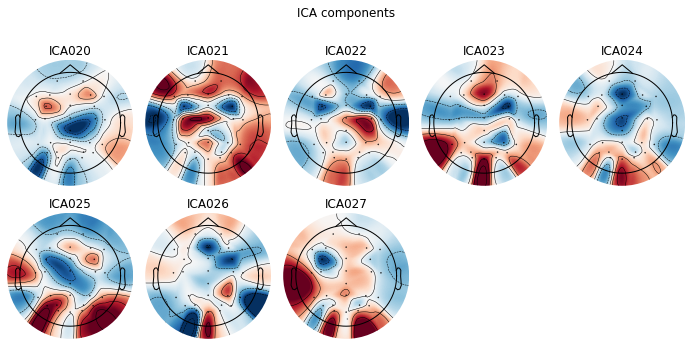

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=742400
    Range : 0 ... 742399 =      0.000 ...   724.999 secs
Ready.
Opening ica-browser...


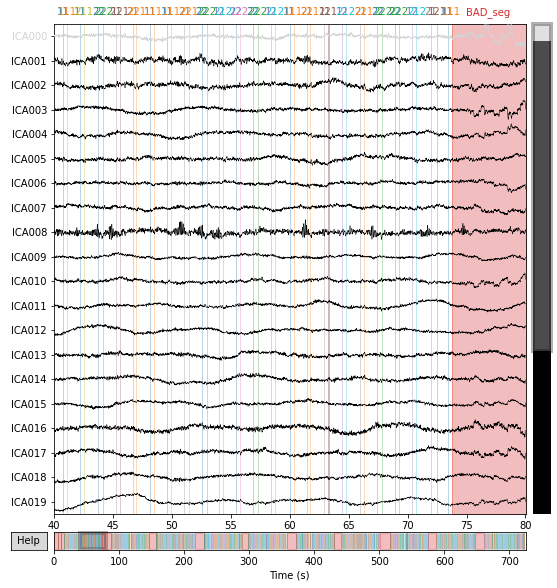

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/22_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/22_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/22_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/23/23_ERN.fdt
Reading 0 ... 707583  =      0.000 ...   690.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=707584
    Range : 0 ... 707583 =      0.000 ...   690.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 99011 of 707584 (13.99%) samples, retaining 608573 (86.01%) samples.
Selecting by number: 28 components
Fitting ICA took 209.5s.
Using EOG channels: VEOG, HEOG
Omitting 99011 of 707584 (13.99%) samples, retaining 608573 (86.01%) samples.
Omitting 99011 of 707584 (13.99%) samples, retaining 608573 (86.01%) samples.
Omitting 99011 of 707584 (13.99%) samples, retaining 608573 (86.01%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

..

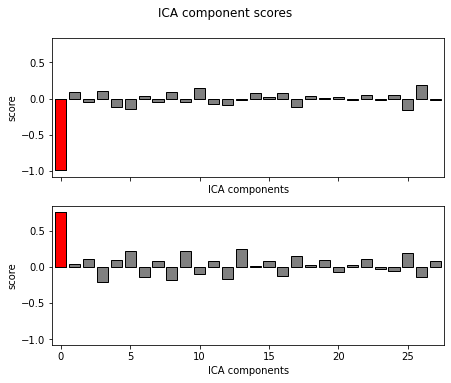

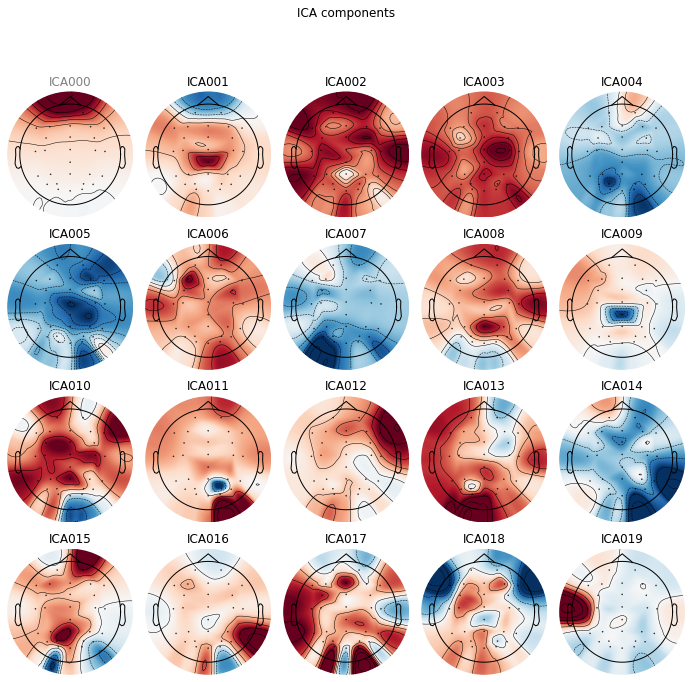

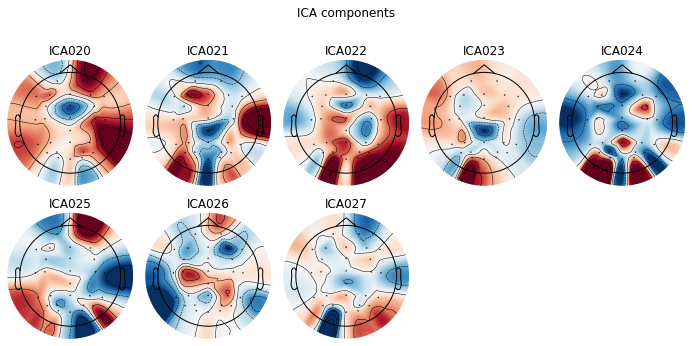

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=707584
    Range : 0 ... 707583 =      0.000 ...   690.999 secs
Ready.
Opening ica-browser...


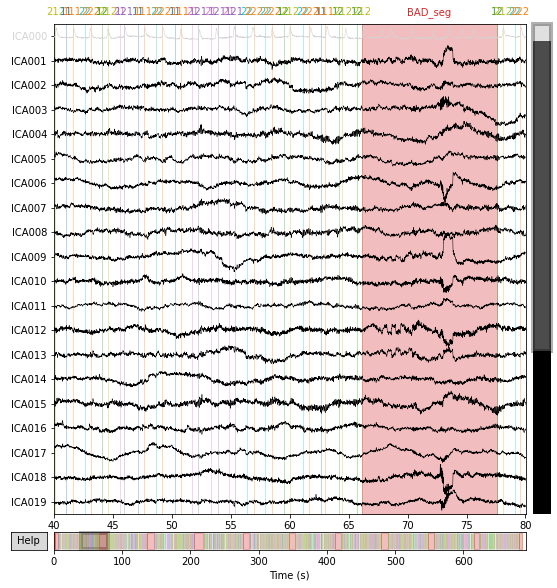

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/23_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/23_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/23_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/24/24_ERN.fdt
Reading 0 ... 737279  =      0.000 ...   719.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=737280
    Range : 0 ... 737279 =      0.000 ...   719.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG


/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 33793 samples (33.001 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 131109 of 737280 (17.78%) samples, retaining 606171 (82.22%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 715.3s.
Using EOG channels: VEOG, HEOG
Omitting 131109 of 737280 (17.78%) samples, retaining 606171 (82.22%) samples.
Omitting 131109 of 737280 (17.78%) samples, retaining 606171 (82.22%) samples.
Omitting 131109 of 737280 (17.78%) samples, retaining 606171 (82.22%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

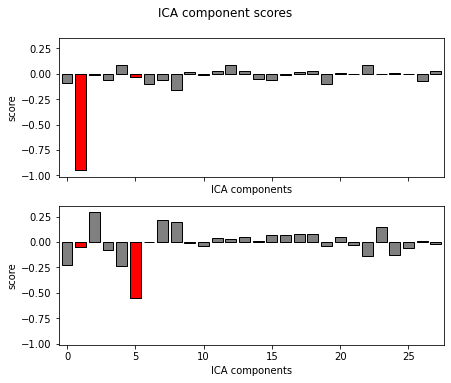

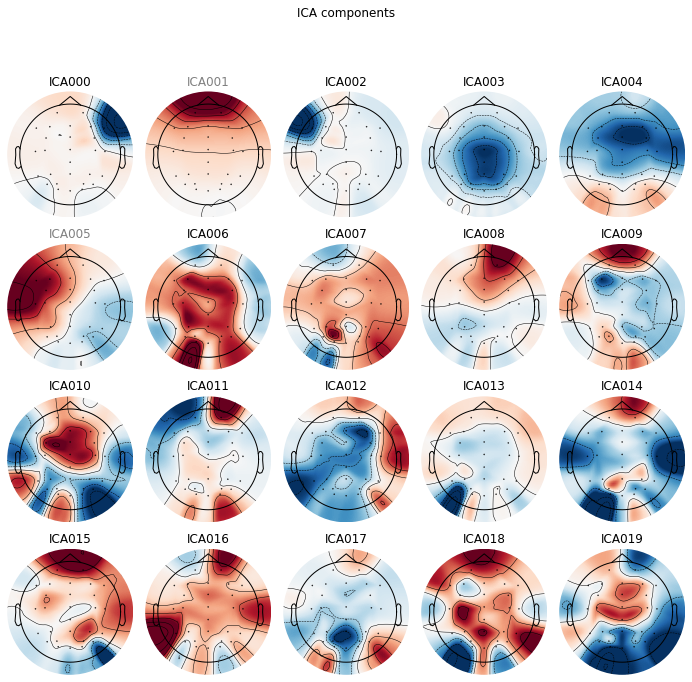

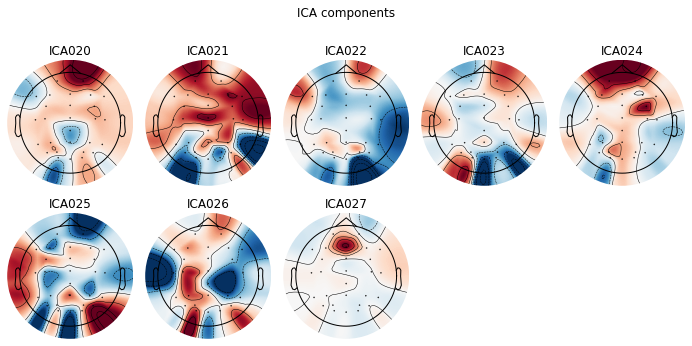

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=737280
    Range : 0 ... 737279 =      0.000 ...   719.999 secs
Ready.
Opening ica-browser...


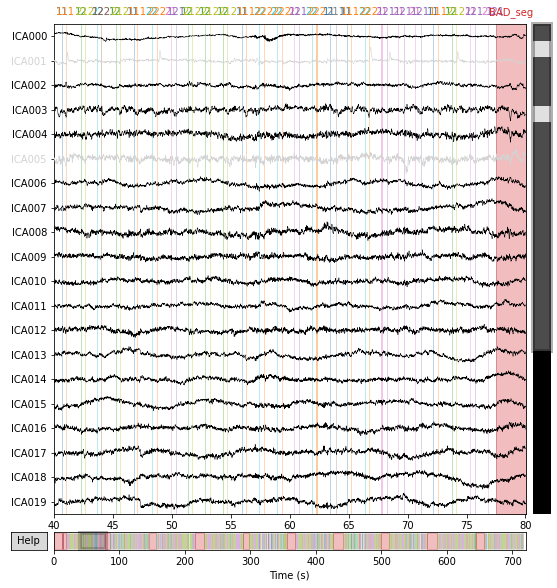

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/24_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/24_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/24_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/25/25_ERN.fdt
Reading 0 ... 767999  =      0.000 ...   749.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=768000
    Range : 0 ... 767999 =      0.000 ...   749.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 157607 of 768000 (20.52%) samples, retaining 610393 (79.48%) samples.
Selecting by number: 28 components
Fitting ICA took 46.5s.
Using EOG channels: VEOG, HEOG
Omitting 157607 of 768000 (20.52%) samples, retaining 610393 (79.48%) samples.
Omitting 157607 of 768000 (20.52%) samples, retaining 610393 (79.48%) samples.
Omitting 157607 of 768000 (20.52%) samples, retaining 610393 (79.48%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


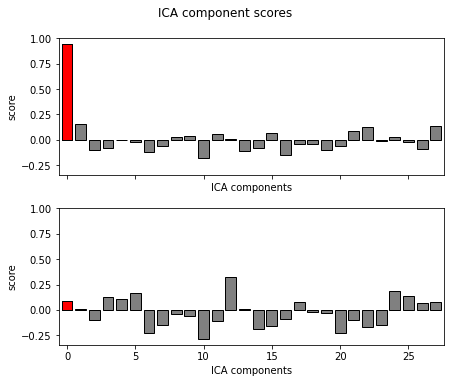

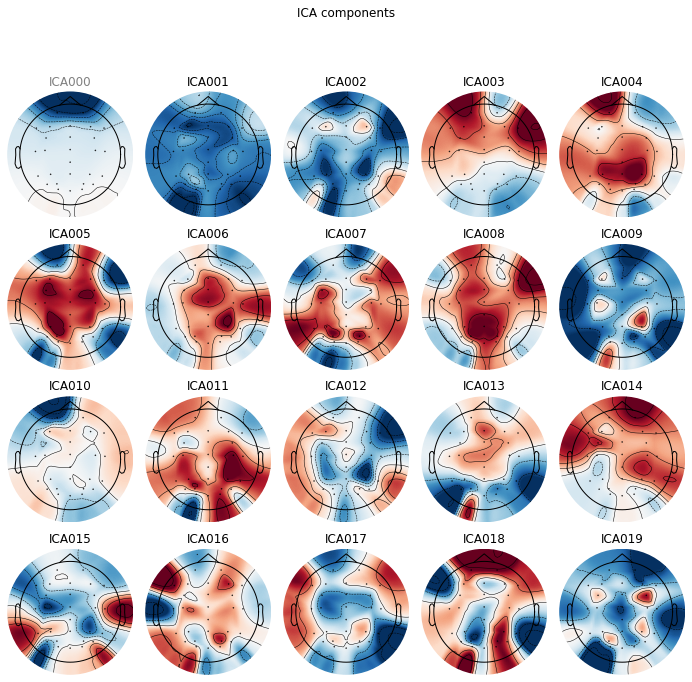

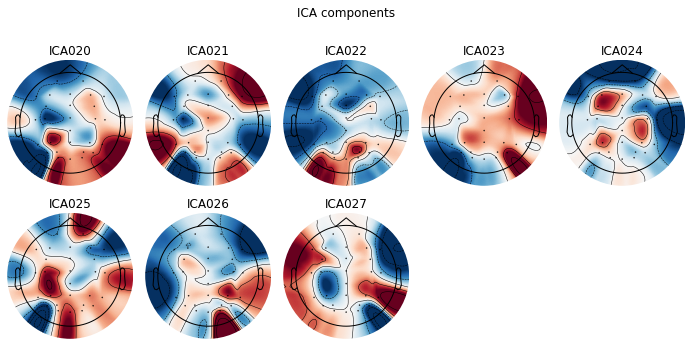

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=768000
    Range : 0 ... 767999 =      0.000 ...   749.999 secs
Ready.
Opening ica-browser...


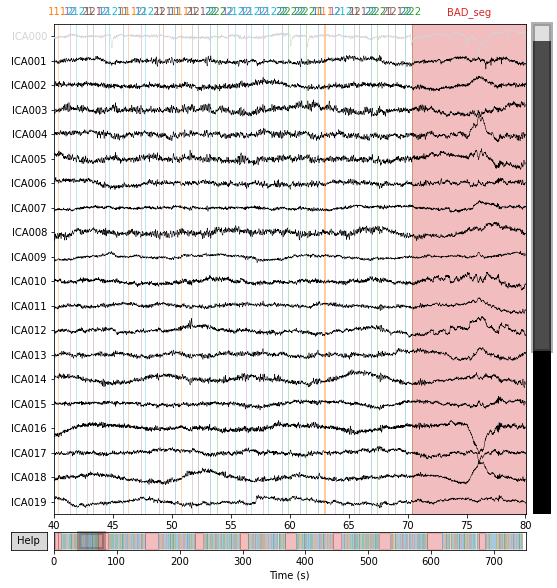

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/25_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/25_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/25_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/26/26_ERN.fdt
Reading 0 ... 759807  =      0.000 ...   741.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=759808
    Range : 0 ... 759807 =      0.000 ...   741.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 150287 of 759808 (19.78%) samples, retaining 609521 (80.22%) samples.
Selecting by number: 28 components
Fitting ICA took 139.1s.
Using EOG channels: VEOG, HEOG
Omitting 150287 of 759808 (19.78%) samples, retaining 609521 (80.22%) samples.
Omitting 150287 of 759808 (19.78%) samples, retaining 609521 (80.22%) samples.
Omitting 150287 of 759808 (19.78%) samples, retaining 609521 (80.22%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

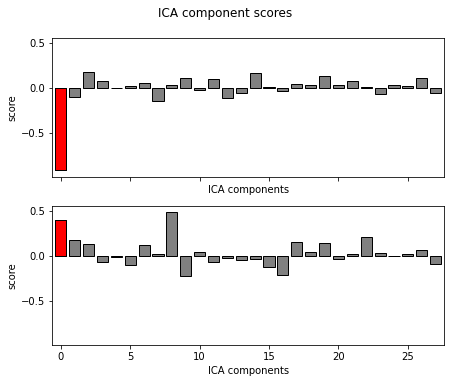

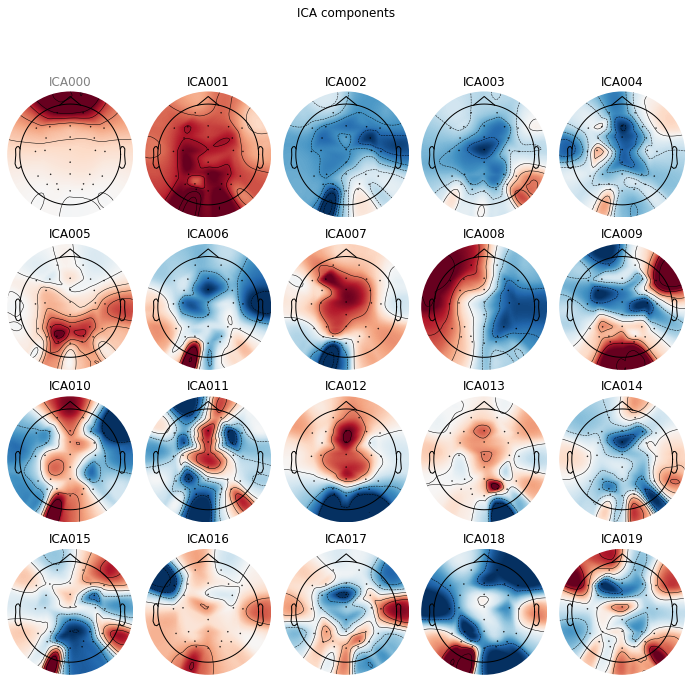

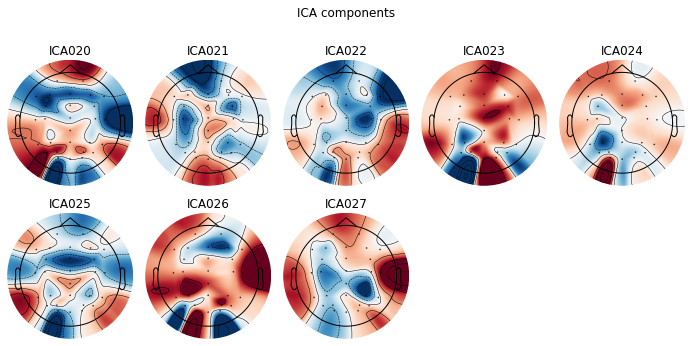

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=759808
    Range : 0 ... 759807 =      0.000 ...   741.999 secs
Ready.
Opening ica-browser...


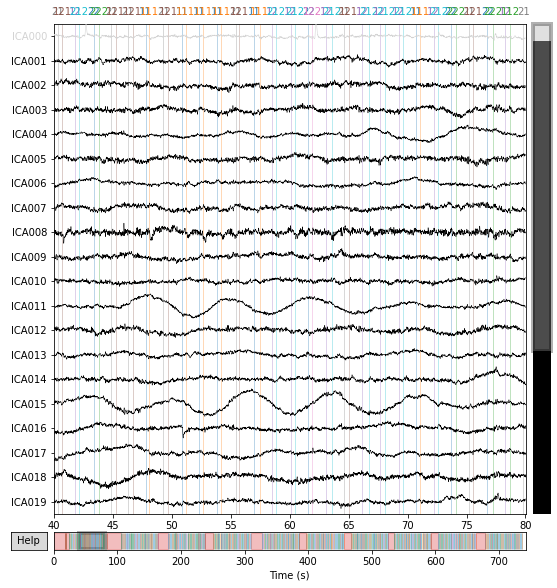

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/26_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/26_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/26_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/27/27_ERN.fdt
Reading 0 ... 743423  =      0.000 ...   725.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=743424
    Range : 0 ... 743423 =      0.000 ...   725.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG


/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 33793 samples (33.001 sec)

Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 136783 of 743424 (18.40%) samples, retaining 606641 (81.60%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 715.6s.
Using EOG channels: VEOG, HEOG
Omitting 136783 of 743424 (18.40%) samples, retaining 606641 (81.60%) samples.
Omitting 136783 of 743424 (18.40%) samples, retaining 606641 (81.60%) samples.
Omitting 136783 of 743424 (18.40%) samples, retaining 606641 (81.60%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

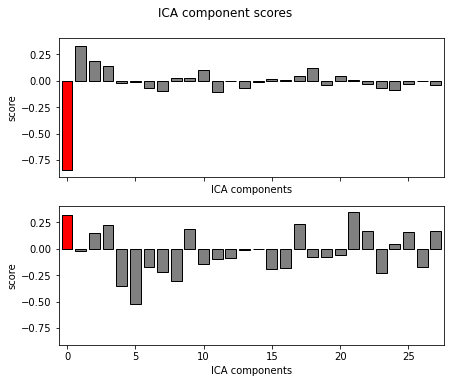

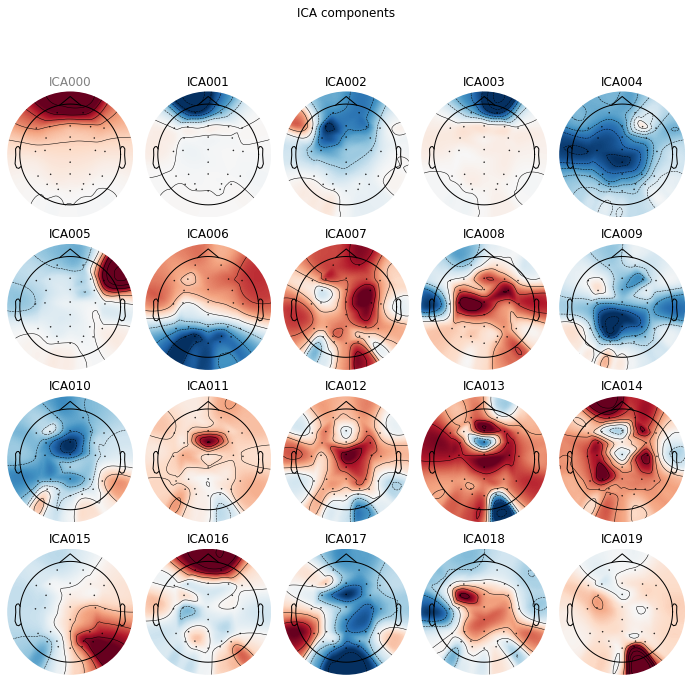

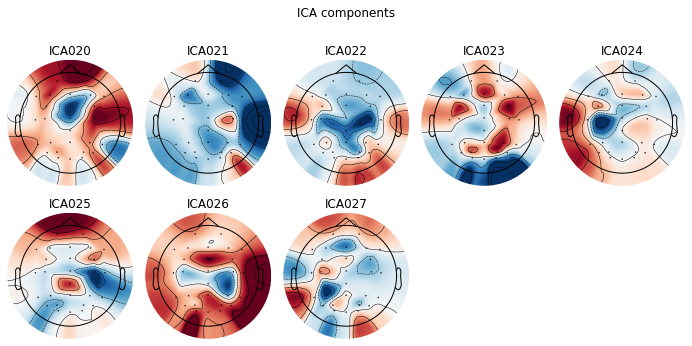

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=743424
    Range : 0 ... 743423 =      0.000 ...   725.999 secs
Ready.
Opening ica-browser...


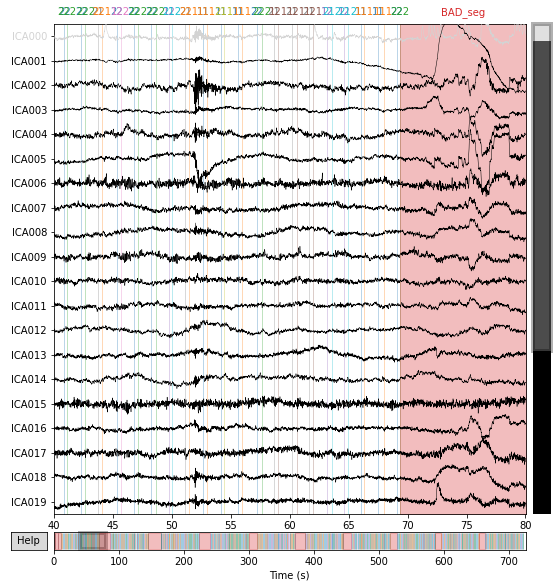

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/27_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/27_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/27_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/28/28_ERN.fdt
Reading 0 ... 730111  =      0.000 ...   712.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=730112
    Range : 0 ... 730111 =      0.000 ...   712.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 119090 of 730112 (16.31%) samples, retaining 611022 (83.69%) samples.
Selecting by number: 28 components
Fitting ICA took 91.2s.
Using EOG channels: VEOG, HEOG
Omitting 119090 of 730112 (16.31%) samples, retaining 611022 (83.69%) samples.
Omitting 119090 of 730112 (16.31%) samples, retaining 611022 (83.69%) samples.
Omitting 119090 of 730112 (16.31%) samples, retaining 611022 (83.69%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


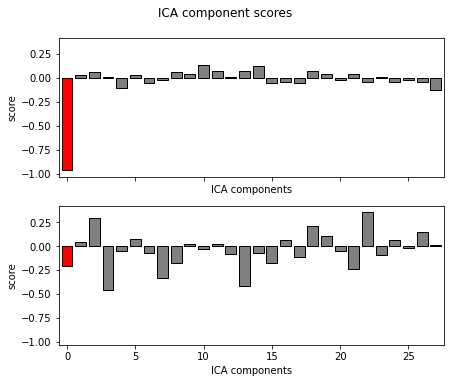

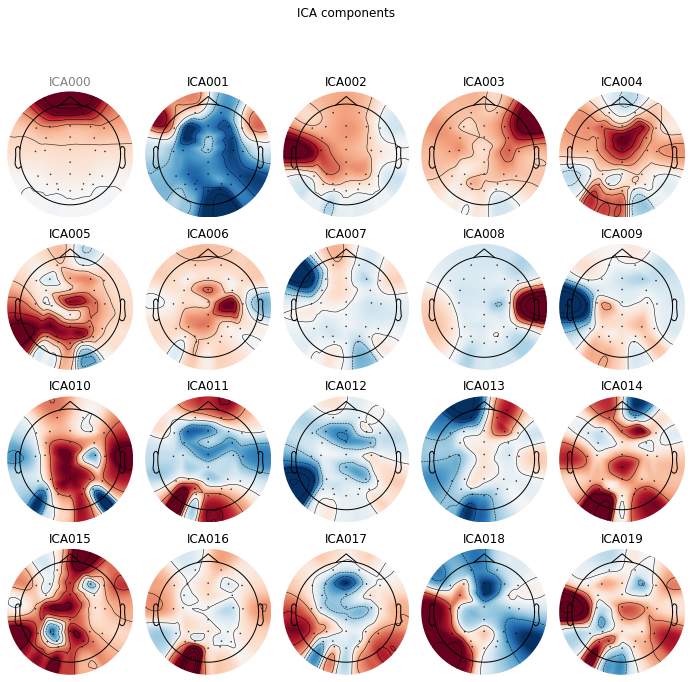

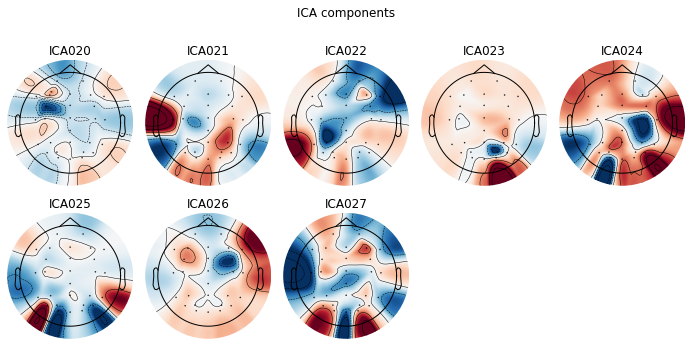

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=730112
    Range : 0 ... 730111 =      0.000 ...   712.999 secs
Ready.
Opening ica-browser...


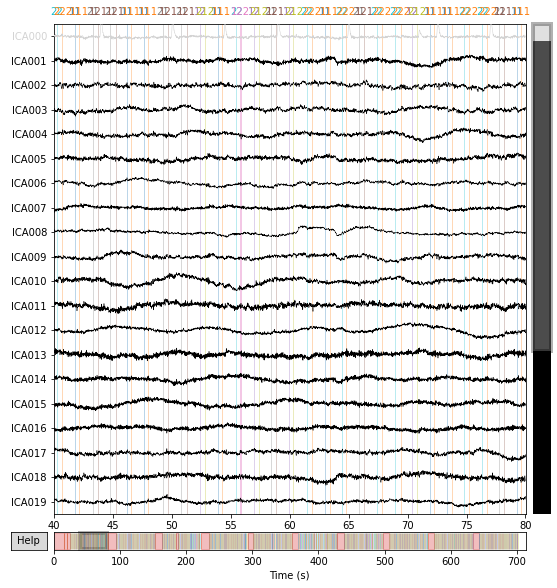

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/28_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/28_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/28_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/29/29_ERN.fdt
Reading 0 ... 713727  =      0.000 ...   696.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=713728
    Range : 0 ... 713727 =      0.000 ...   696.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 107723 of 713728 (15.09%) samples, retaining 606005 (84.91%) samples.
Selecting by number: 28 components
Fitting ICA took 361.1s.
Using EOG channels: VEOG, HEOG
Omitting 107723 of 713728 (15.09%) samples, retaining 606005 (84.91%) samples.
Omitting 107723 of 713728 (15.09%) samples, retaining 606005 (84.91%) samples.
Omitting 107723 of 713728 (15.09%) samples, retaining 606005 (84.91%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

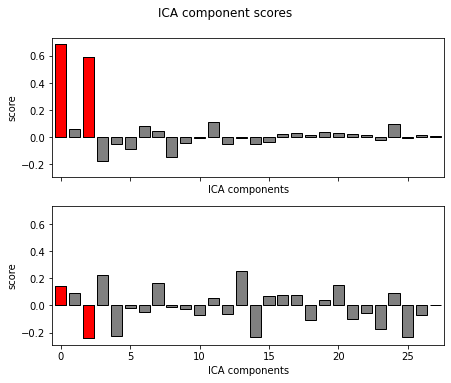

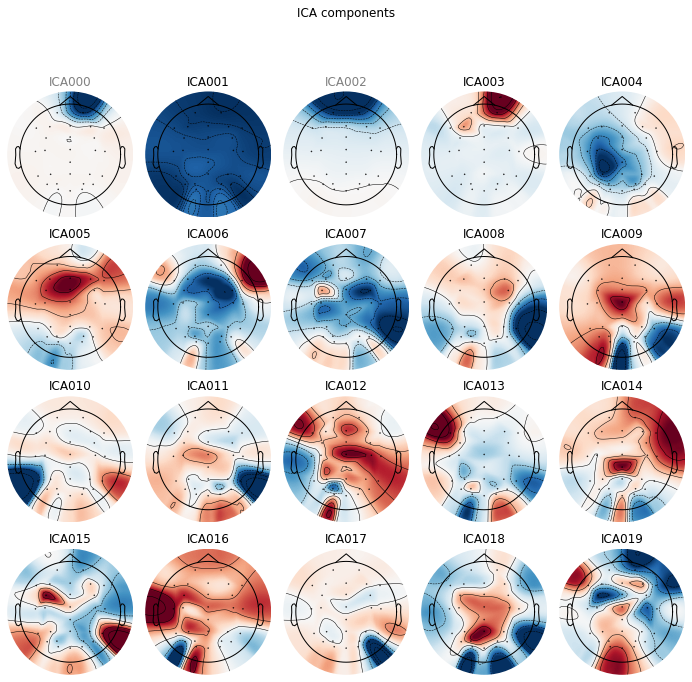

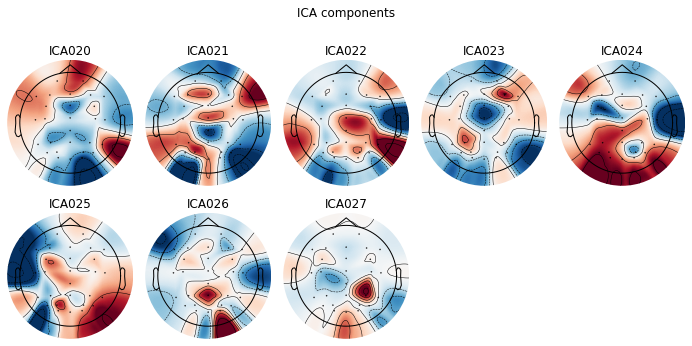

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=713728
    Range : 0 ... 713727 =      0.000 ...   696.999 secs
Ready.
Opening ica-browser...


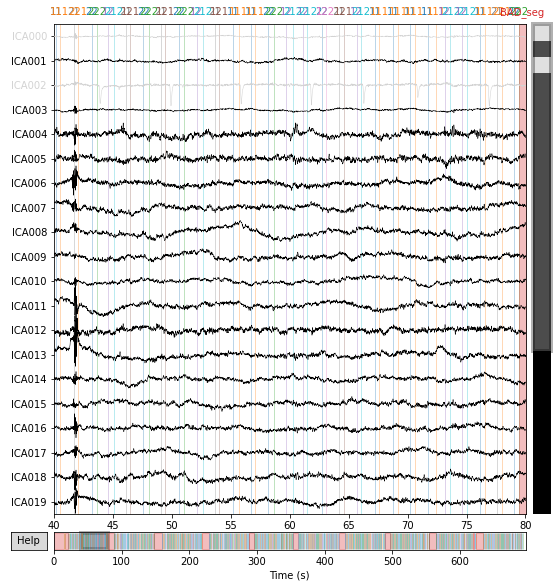

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/29_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/29_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/29_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/30/30_ERN.fdt
Reading 0 ... 765951  =      0.000 ...   747.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=765952
    Range : 0 ... 765951 =      0.000 ...   747.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 158798 of 765952 (20.73%) samples, retaining 607154 (79.27%) samples.
Selecting by number: 28 components
Fitting ICA took 58.1s.
Using EOG channels: VEOG, HEOG
Omitting 158798 of 765952 (20.73%) samples, retaining 607154 (79.27%) samples.
Omitting 158798 of 765952 (20.73%) samples, retaining 607154 (79.27%) samples.
Omitting 158798 of 765952 (20.73%) samples, retaining 607154 (79.27%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


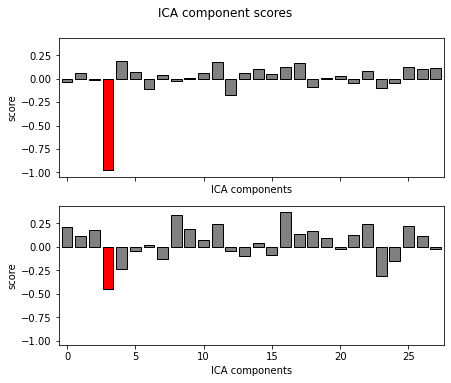

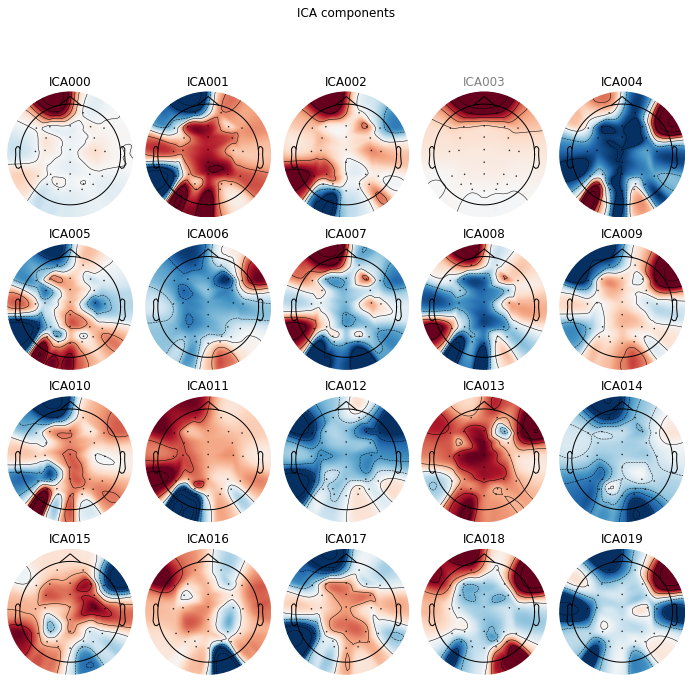

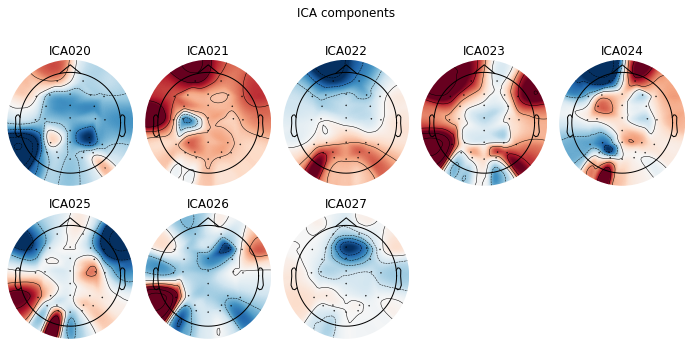

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=765952
    Range : 0 ... 765951 =      0.000 ...   747.999 secs
Ready.
Opening ica-browser...


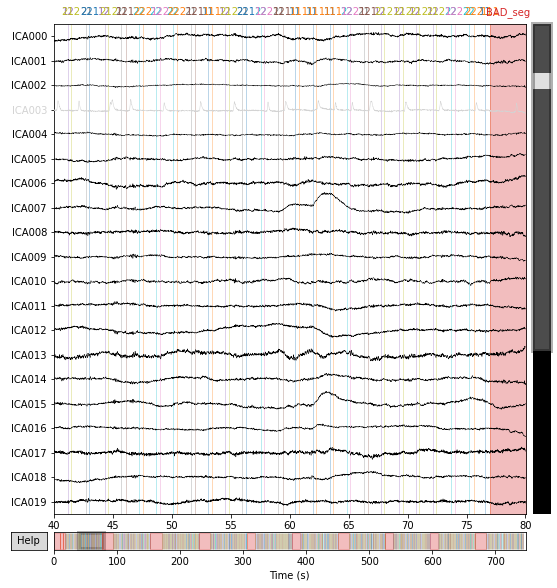

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/30_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/30_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/30_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/31/31_ERN.fdt
Reading 0 ... 823295  =      0.000 ...   803.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=823296
    Range : 0 ... 823295 =      0.000 ...   803.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 213211 of 823296 (25.90%) samples, retaining 610085 (74.10%) samples.
Selecting by number: 28 components
Fitting ICA took 50.7s.
Using EOG channels: VEOG, HEOG
Omitting 213211 of 823296 (25.90%) samples, retaining 610085 (74.10%) samples.
Omitting 213211 of 823296 (25.90%) samples, retaining 610085 (74.10%) samples.
Omitting 213211 of 823296 (25.90%) samples, retaining 610085 (74.10%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


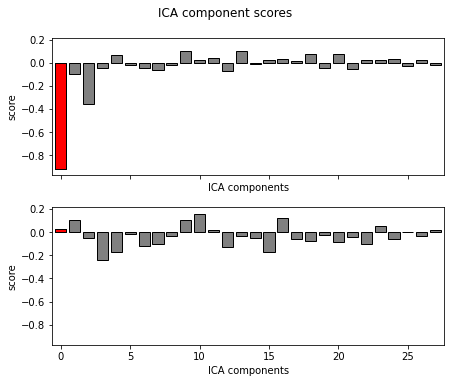

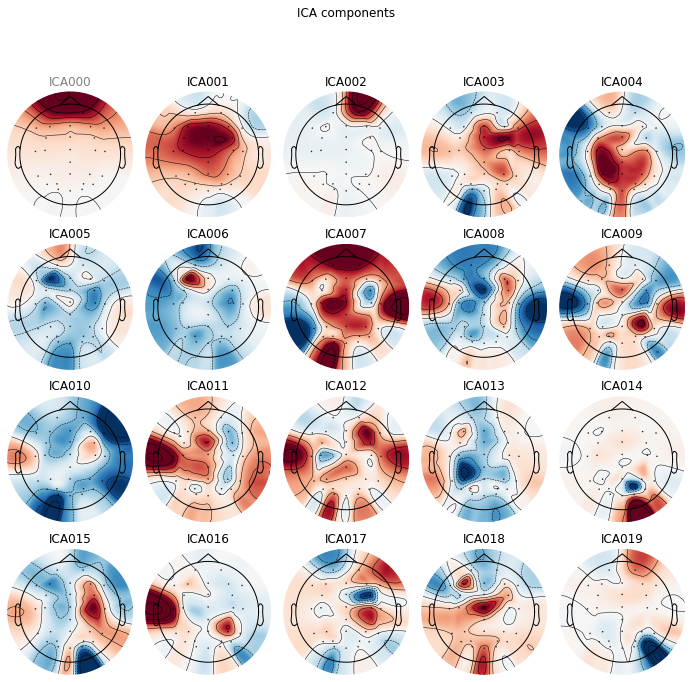

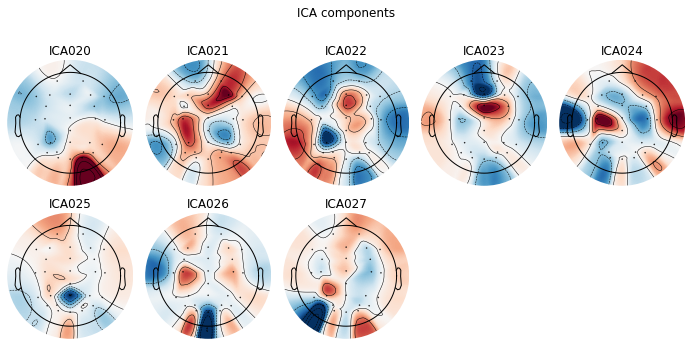

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=823296
    Range : 0 ... 823295 =      0.000 ...   803.999 secs
Ready.
Opening ica-browser...


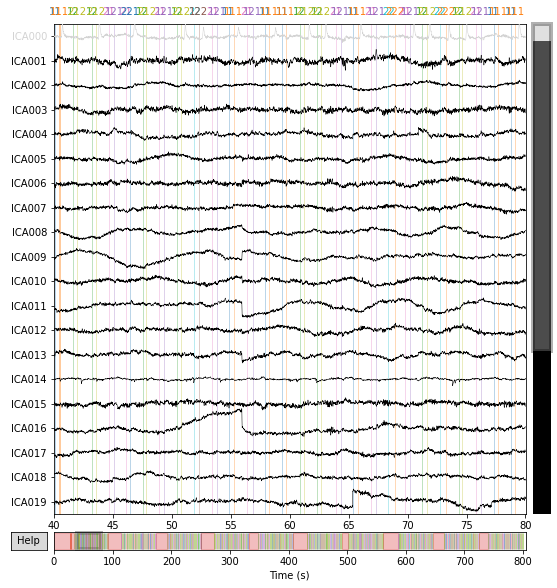

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/31_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/31_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/31_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/32/32_ERN.fdt
Reading 0 ... 799743  =      0.000 ...   780.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=799744
    Range : 0 ... 799743 =      0.000 ...   780.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 189681 of 799744 (23.72%) samples, retaining 610063 (76.28%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 714.1s.
Using EOG channels: VEOG, HEOG
Omitting 189681 of 799744 (23.72%) samples, retaining 610063 (76.28%) samples.
Omitting 189681 of 799744 (23.72%) samples, retaining 610063 (76.28%) samples.
Omitting 189681 of 799744 (23.72%) samples, retaining 610063 (76.28%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

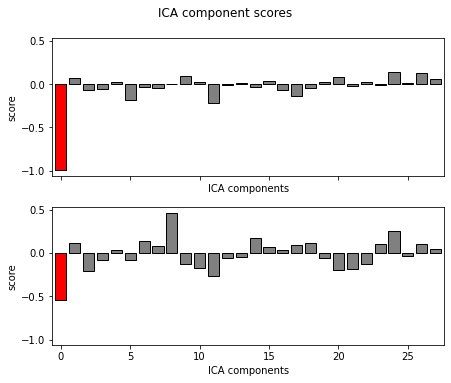

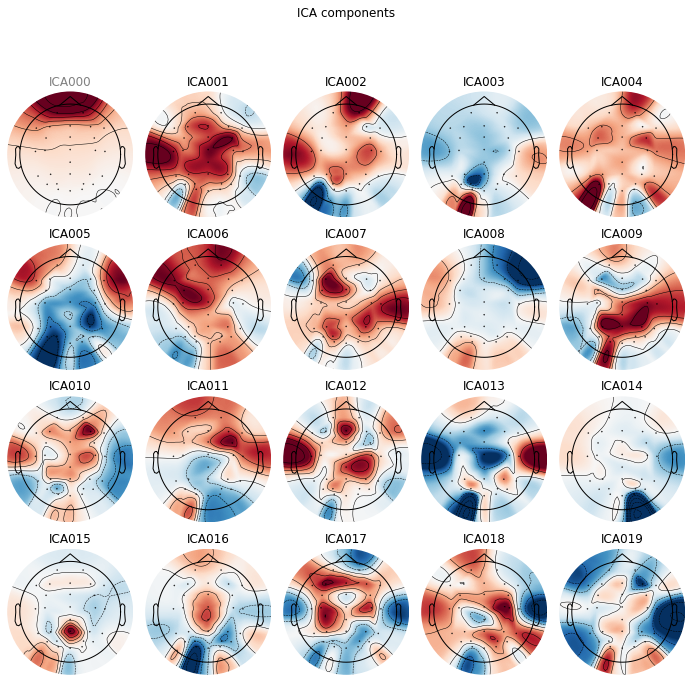

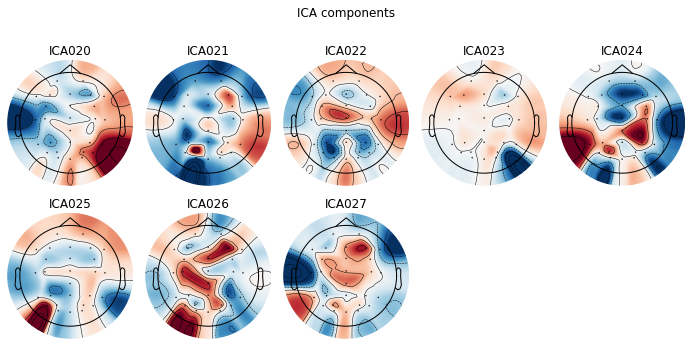

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=799744
    Range : 0 ... 799743 =      0.000 ...   780.999 secs
Ready.
Opening ica-browser...


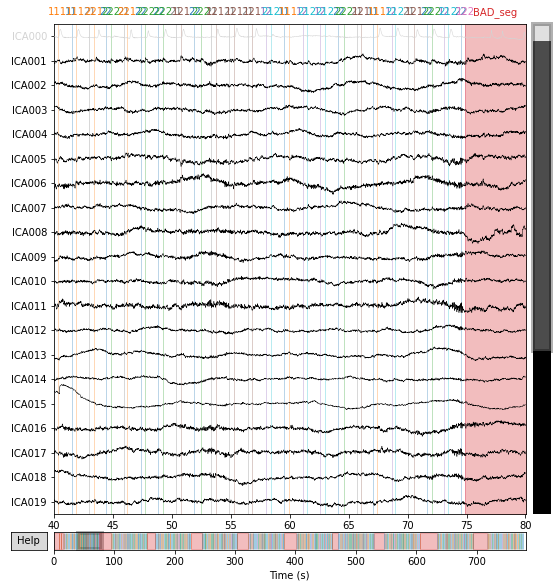

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/32_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/32_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/32_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/33/33_ERN.fdt
Reading 0 ... 766975  =      0.000 ...   748.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=766976
    Range : 0 ... 766975 =      0.000 ...   748.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 161221 of 766976 (21.02%) samples, retaining 605755 (78.98%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 720.4s.
Using EOG channels: VEOG, HEOG
Omitting 161221 of 766976 (21.02%) samples, retaining 605755 (78.98%) samples.
Omitting 161221 of 766976 (21.02%) samples, retaining 605755 (78.98%) samples.
Omitting 161221 of 766976 (21.02%) samples, retaining 605755 (78.98%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

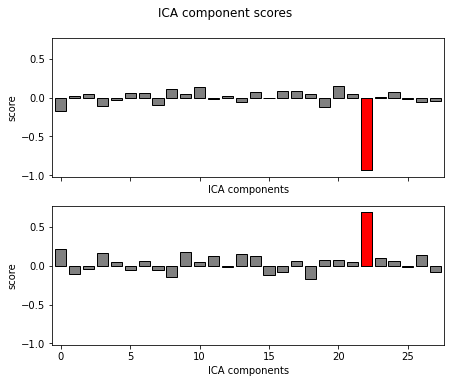

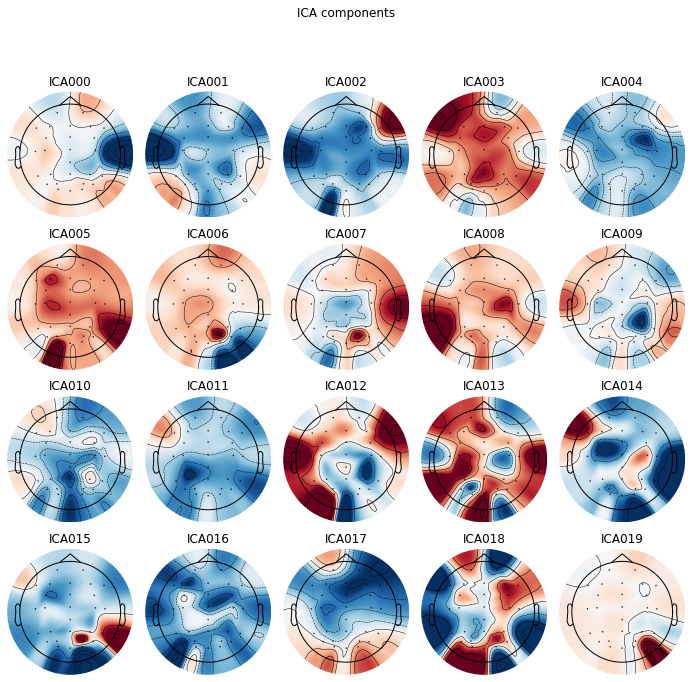

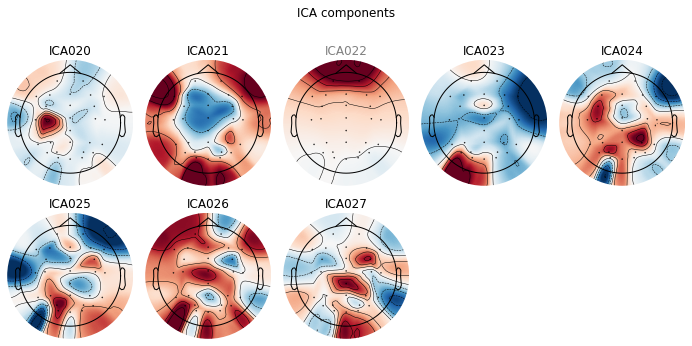

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=766976
    Range : 0 ... 766975 =      0.000 ...   748.999 secs
Ready.
Opening ica-browser...


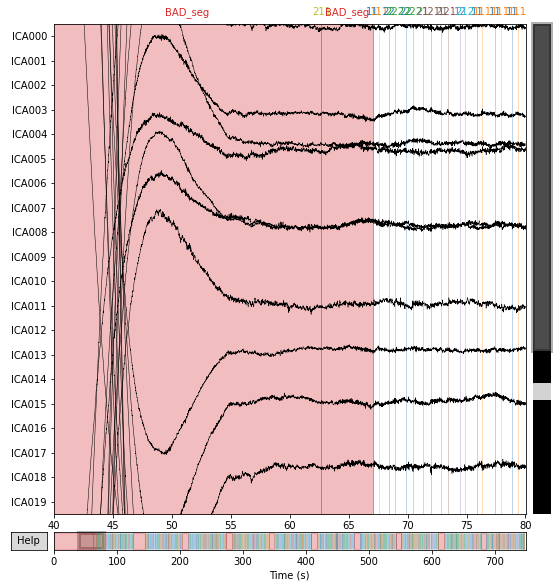

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/33_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/33_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/33_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/34/34_ERN.fdt
Reading 0 ... 777215  =      0.000 ...   758.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=777216
    Range : 0 ... 777215 =      0.000 ...   758.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 161934 of 777216 (20.84%) samples, retaining 615282 (79.16%) samples.
Selecting by number: 28 components
Fitting ICA took 38.9s.
Using EOG channels: VEOG, HEOG
Omitting 161934 of 777216 (20.84%) samples, retaining 615282 (79.16%) samples.
Omitting 161934 of 777216 (20.84%) samples, retaining 615282 (79.16%) samples.
Omitting 161934 of 777216 (20.84%) samples, retaining 615282 (79.16%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


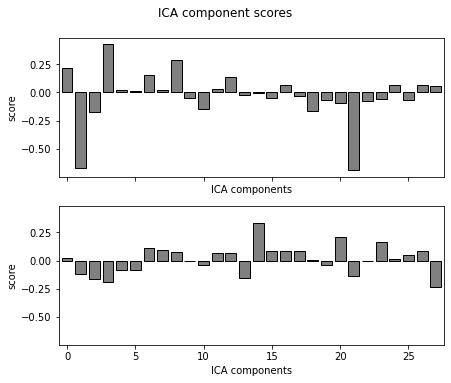

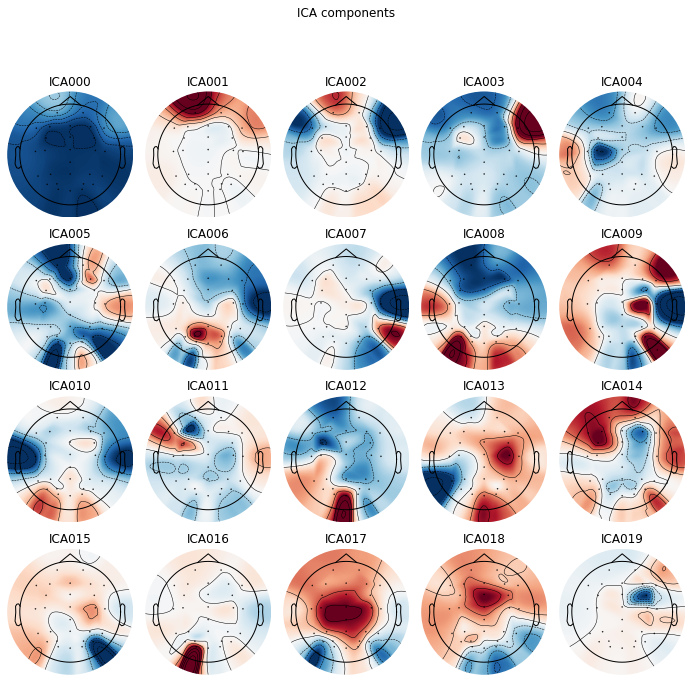

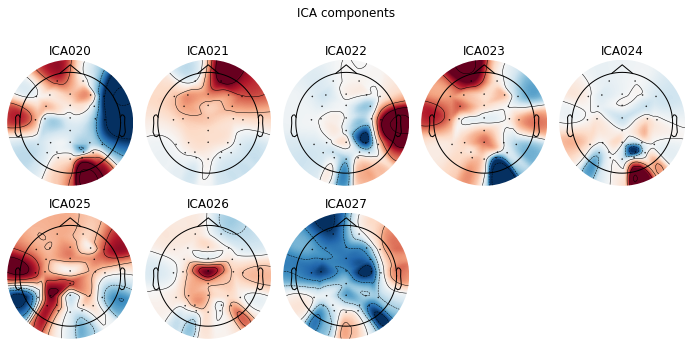

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=777216
    Range : 0 ... 777215 =      0.000 ...   758.999 secs
Ready.
Opening ica-browser...


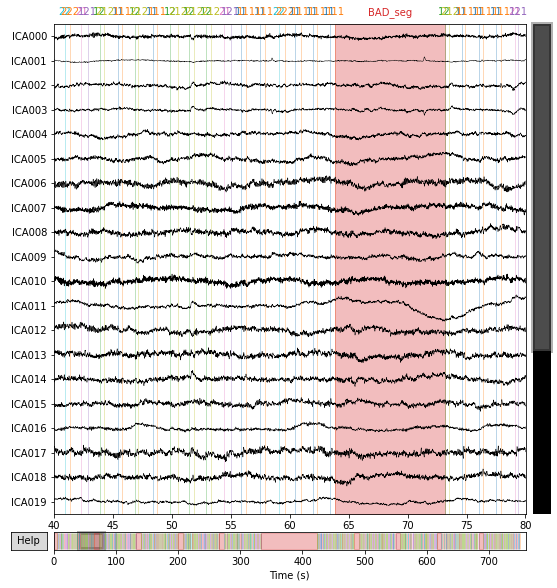

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 0 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/34_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/34_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/34_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/35/35_ERN.fdt
Reading 0 ... 774143  =      0.000 ...   755.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=774144
    Range : 0 ... 774143 =      0.000 ...   755.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 165490 of 774144 (21.38%) samples, retaining 608654 (78.62%) samples.
Selecting by number: 28 components
Fitting ICA took 95.8s.
Using EOG channels: VEOG, HEOG
Omitting 165490 of 774144 (21.38%) samples, retaining 608654 (78.62%) samples.
Omitting 165490 of 774144 (21.38%) samples, retaining 608654 (78.62%) samples.
Omitting 165490 of 774144 (21.38%) samples, retaining 608654 (78.62%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


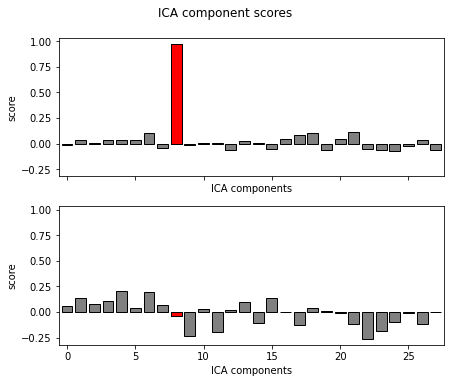

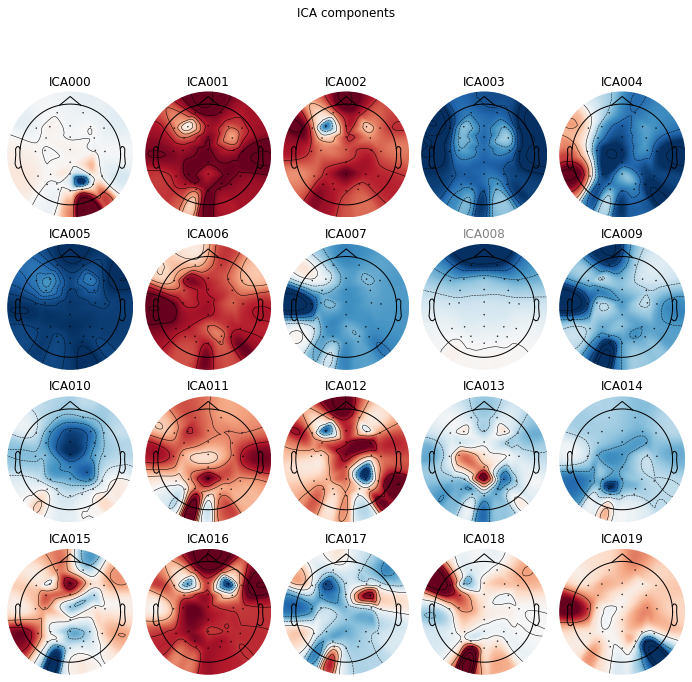

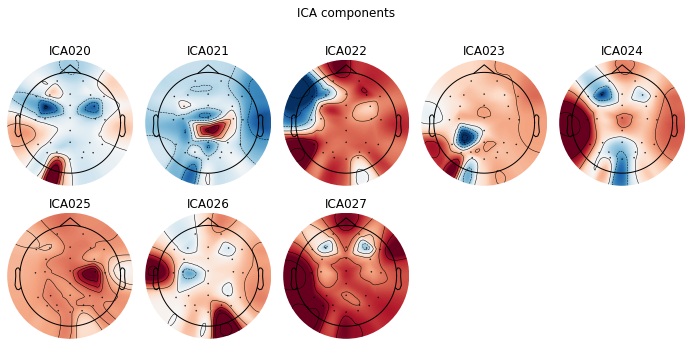

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=774144
    Range : 0 ... 774143 =      0.000 ...   755.999 secs
Ready.
Opening ica-browser...


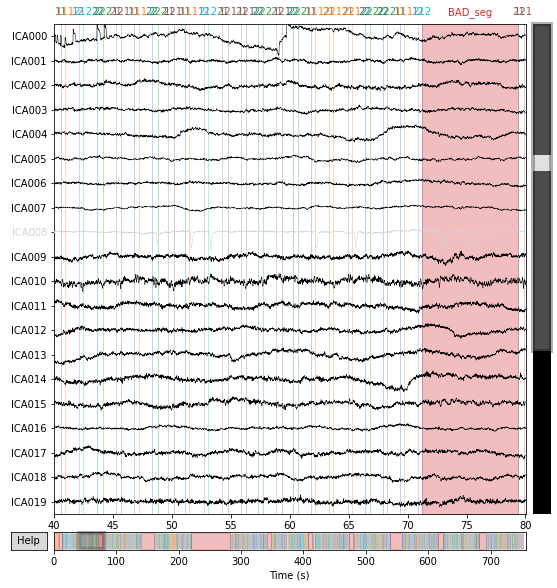

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/35_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/35_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/35_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/36/36_ERN.fdt
Reading 0 ... 790527  =      0.000 ...   771.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=790528
    Range : 0 ... 790527 =      0.000 ...   771.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 180009 of 790528 (22.77%) samples, retaining 610519 (77.23%) samples.
Selecting by number: 28 components
Fitting ICA took 267.5s.
Using EOG channels: VEOG, HEOG
Omitting 180009 of 790528 (22.77%) samples, retaining 610519 (77.23%) samples.
Omitting 180009 of 790528 (22.77%) samples, retaining 610519 (77.23%) samples.
Omitting 180009 of 790528 (22.77%) samples, retaining 610519 (77.23%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

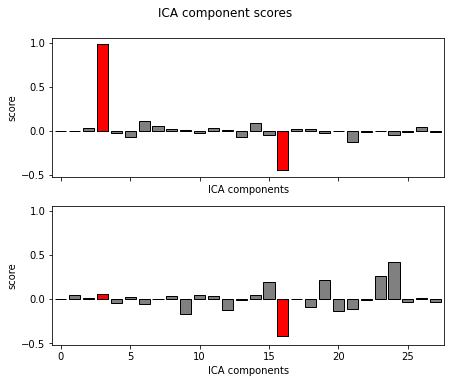

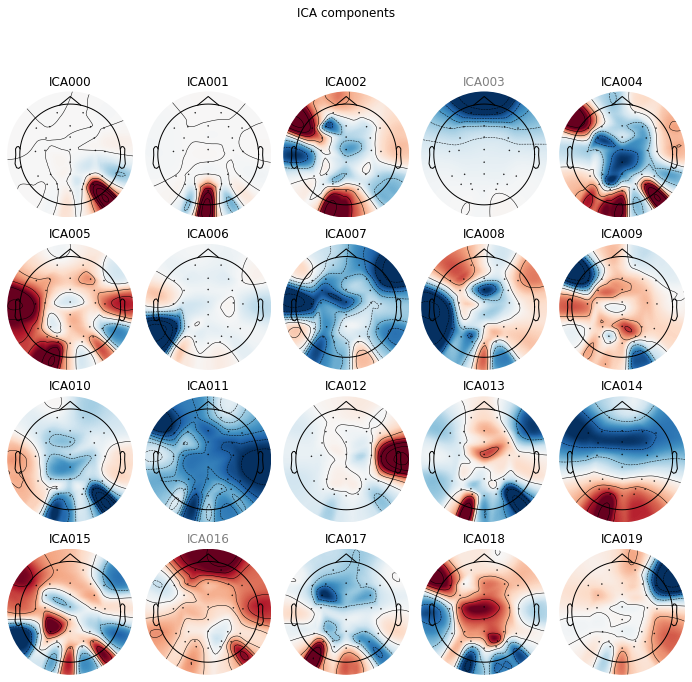

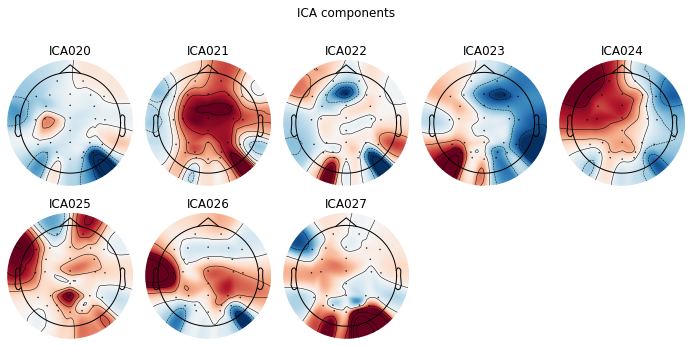

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=790528
    Range : 0 ... 790527 =      0.000 ...   771.999 secs
Ready.
Opening ica-browser...


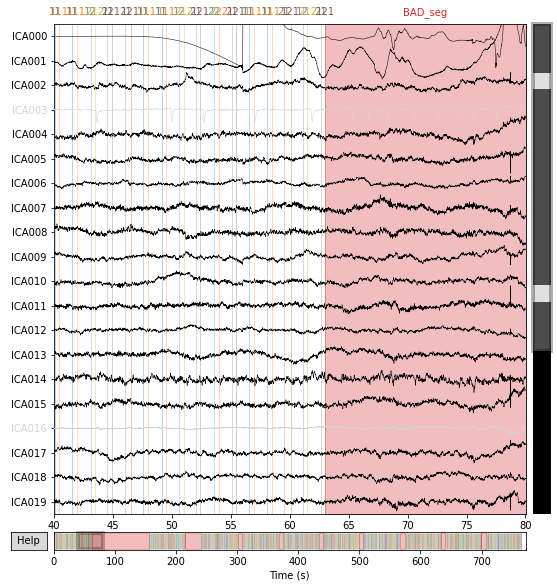

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/36_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/36_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/36_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/37/37_ERN.fdt
Reading 0 ... 746495  =      0.000 ...   728.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=746496
    Range : 0 ... 746495 =      0.000 ...   728.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 127577 of 746496 (17.09%) samples, retaining 618919 (82.91%) samples.
Selecting by number: 28 components


/opt/conda/lib/python3.7/site-packages/sklearn/decomposition/_fastica.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning,


Fitting ICA took 724.6s.
Using EOG channels: VEOG, HEOG
Omitting 127577 of 746496 (17.09%) samples, retaining 618919 (82.91%) samples.
Omitting 127577 of 746496 (17.09%) samples, retaining 618919 (82.91%) samples.
Omitting 127577 of 746496 (17.09%) samples, retaining 618919 (82.91%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- 

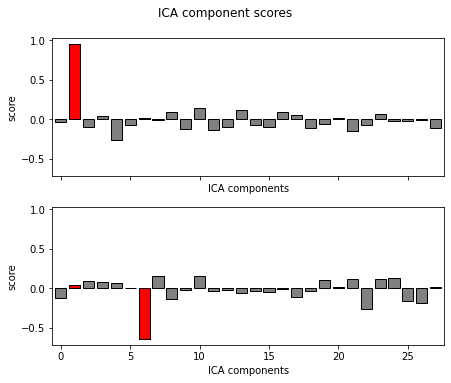

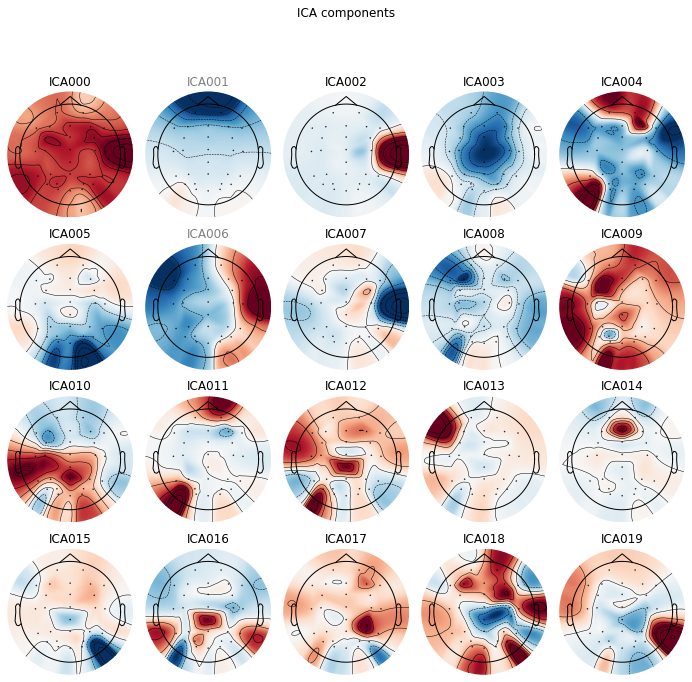

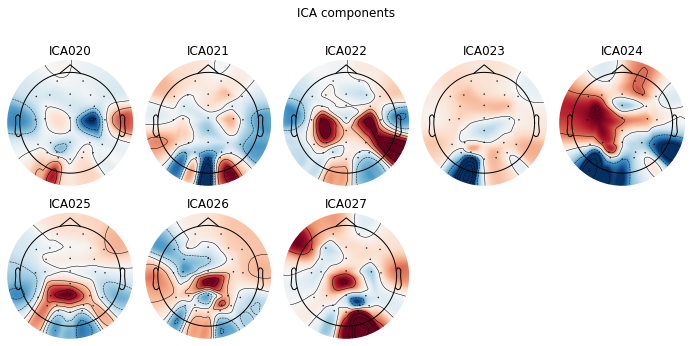

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=746496
    Range : 0 ... 746495 =      0.000 ...   728.999 secs
Ready.
Opening ica-browser...


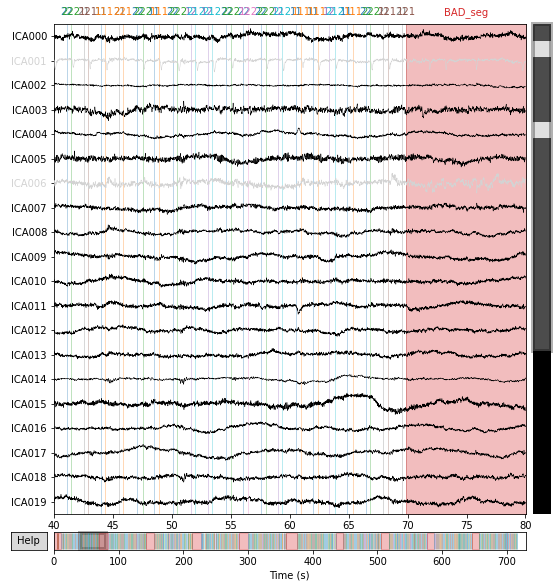

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/37_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/37_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/37_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/38/38_ERN.fdt
Reading 0 ... 1069055  =      0.000 ...  1043.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=1069056
    Range : 0 ... 1069055 =      0.000 ...  1043.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff 

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 458841 of 1069056 (42.92%) samples, retaining 610215 (57.08%) samples.
Selecting by number: 28 components
Fitting ICA took 124.2s.
Using EOG channels: VEOG, HEOG
Omitting 458841 of 1069056 (42.92%) samples, retaining 610215 (57.08%) samples.
Omitting 458841 of 1069056 (42.92%) samples, retaining 610215 (57.08%) samples.
Omitting 458841 of 1069056 (42.92%) samples, retaining 610215 (57.08%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 

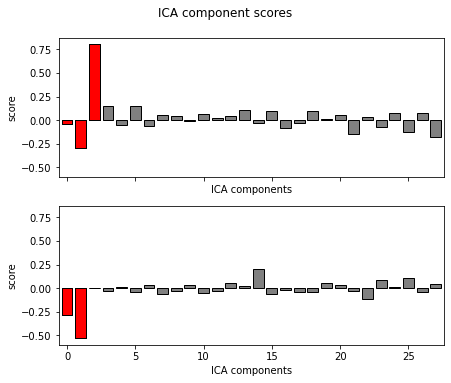

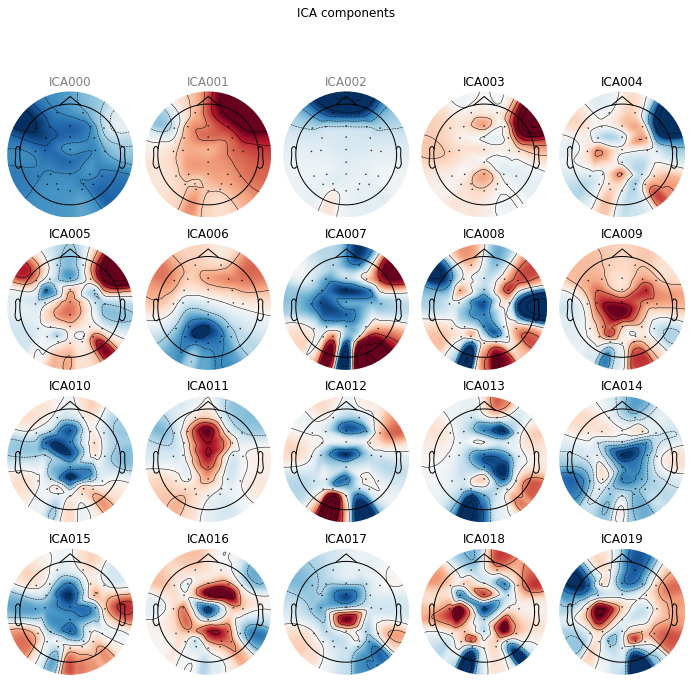

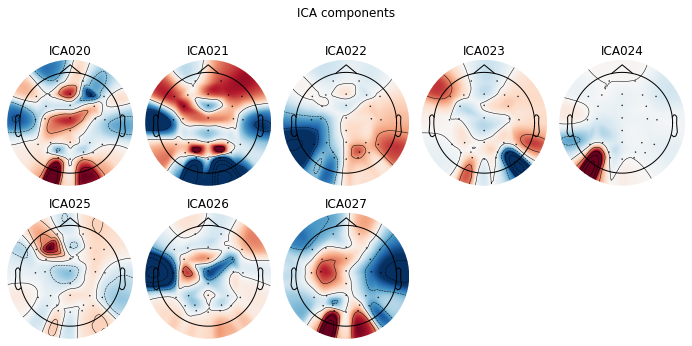

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=1069056
    Range : 0 ... 1069055 =      0.000 ...  1043.999 secs
Ready.
Opening ica-browser...


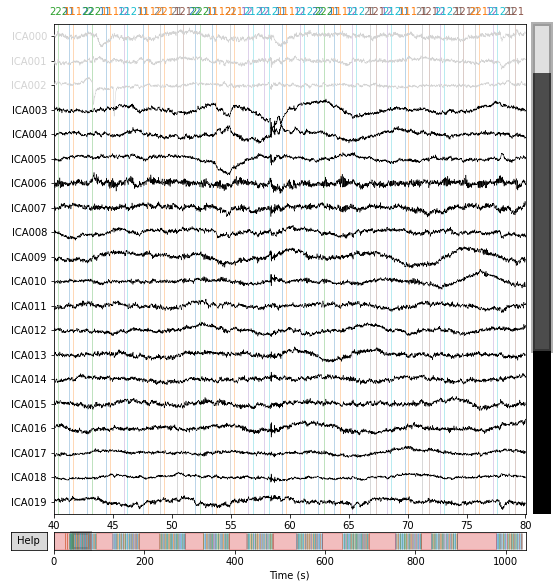

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 3 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/38_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/38_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/38_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/39/39_ERN.fdt
Reading 0 ... 829439  =      0.000 ...   809.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=829440
    Range : 0 ... 829439 =      0.000 ...   809.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 217841 of 829440 (26.26%) samples, retaining 611599 (73.74%) samples.
Selecting by number: 28 components
Fitting ICA took 167.9s.
Using EOG channels: VEOG, HEOG
Omitting 217841 of 829440 (26.26%) samples, retaining 611599 (73.74%) samples.
Omitting 217841 of 829440 (26.26%) samples, retaining 611599 (73.74%) samples.
Omitting 217841 of 829440 (26.26%) samples, retaining 611599 (73.74%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)

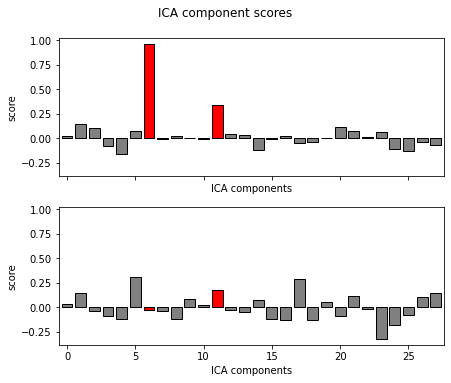

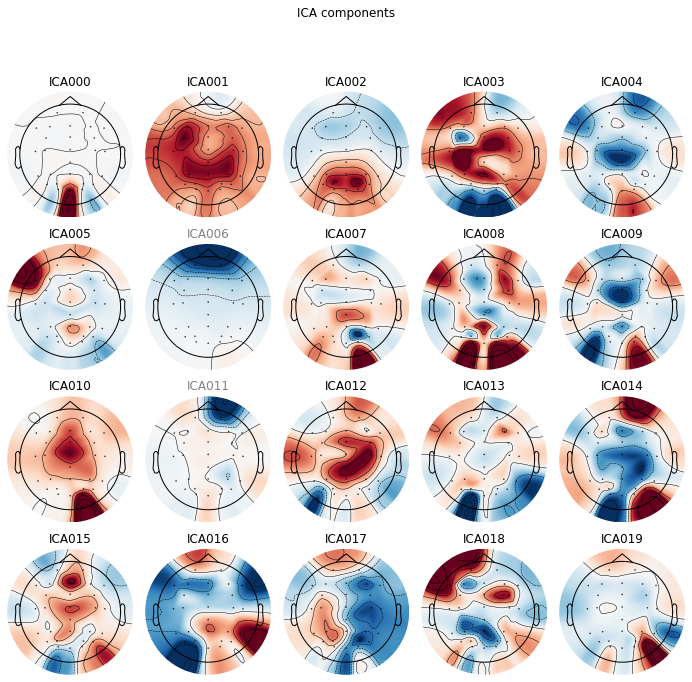

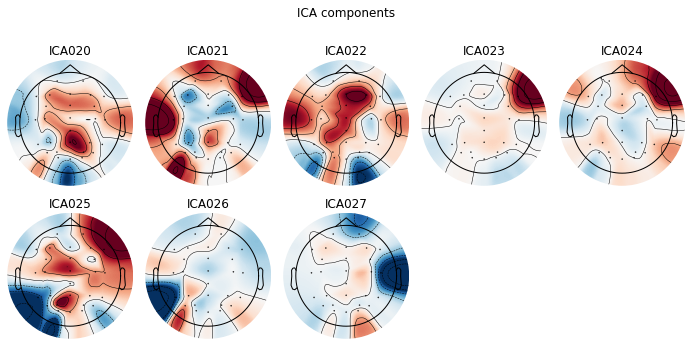

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=829440
    Range : 0 ... 829439 =      0.000 ...   809.999 secs
Ready.
Opening ica-browser...


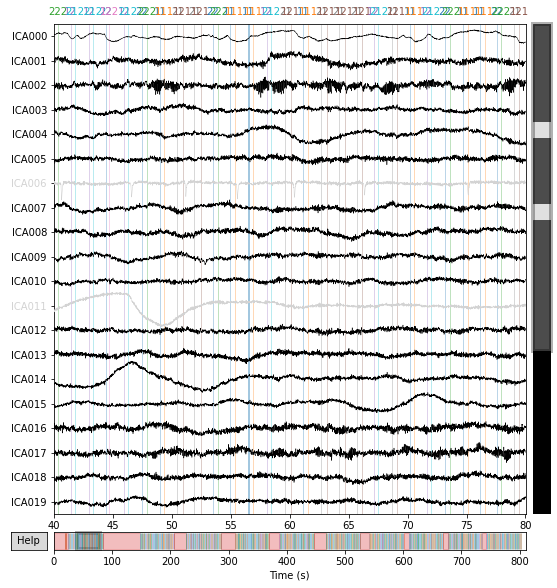

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 2 ICA components
    Projecting back using 30 PCA components
Writing /kaggle/working/39_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/39_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/39_eeg_ica.fif
[done]
Reading /kaggle/working/../input/ern-data/ERN Raw Data and Scripts Only/40/40_ERN.fdt
Reading 0 ... 899071  =      0.000 ...   877.999 secs...
EEG channel type selected for re-referencing
Applying a custom ('EEG',) reference.
EEG channel type selected for re-referencing
Creating RawArray with float64 data, n_channels=2, n_times=899072
    Range : 0 ... 899071 =      0.000 ...   877.999 secs
Ready.
Added the following bipolar channels:
VEOG, HEOG
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff fre

/tmp/ipykernel_19/842611133.py:21: RuntimeWarning: Not setting positions of 2 eog channels found in montage:
['VEOG', 'HEOG']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw.set_montage(montage, match_case=False, on_missing='ignore')


Fitting ICA to data using 30 channels (please be patient, this may take a while)
Omitting 284699 of 899072 (31.67%) samples, retaining 614373 (68.33%) samples.
Selecting by number: 28 components
Fitting ICA took 49.0s.
Using EOG channels: VEOG, HEOG
Omitting 284699 of 899072 (31.67%) samples, retaining 614373 (68.33%) samples.
Omitting 284699 of 899072 (31.67%) samples, retaining 614373 (68.33%) samples.
Omitting 284699 of 899072 (31.67%) samples, retaining 614373 (68.33%) samples.
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10240 samples (10.000 sec)


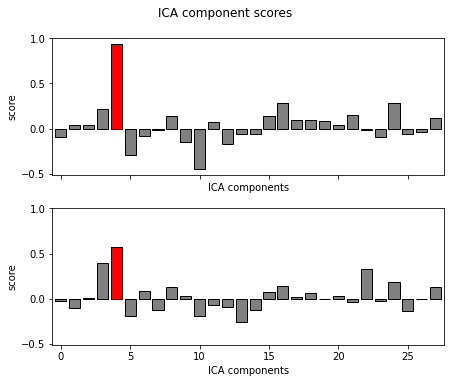

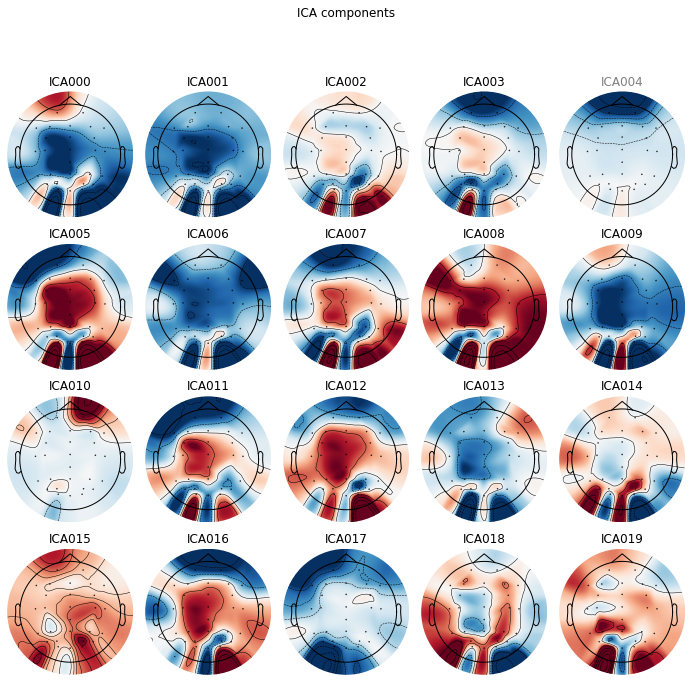

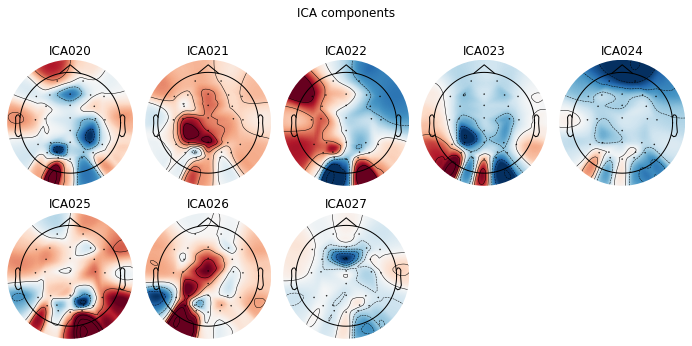

Overwriting existing file.
Writing ICA solution to /kaggle/working/1-ica.fif...
Creating RawArray with float64 data, n_channels=30, n_times=899072
    Range : 0 ... 899071 =      0.000 ...   877.999 secs
Ready.
Opening ica-browser...


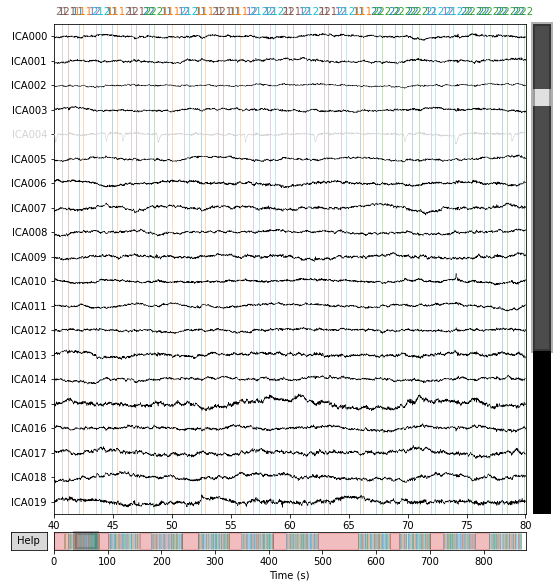

Applying ICA to Raw instance
    Transforming to ICA space (28 components)
    Zeroing out 1 ICA component
    Projecting back using 30 PCA components
Writing /kaggle/working/40_eeg_ica.fif


/tmp/ipykernel_19/842611133.py:65: RuntimeWarning: This filename (/kaggle/working/40_eeg_ica.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw.save(f'{id}_eeg_ica.fif')


Closing /kaggle/working/40_eeg_ica.fif
[done]


In [ ]:
 for id in range(1,41):
    raw = mne.io.read_raw_eeglab(f'../input/ern-data/ERN Raw Data and Scripts Only/{id}/{id}_ERN.set', preload='True')

    raw.set_eeg_reference(['P9','P10'])

    mne.set_bipolar_reference(
        inst = raw,
        anode = ['VEOG_lower', 'HEOG_left'],
        cathode = ['FP2', 'HEOG_right'],
        ch_name = ['VEOG', 'HEOG'],
        drop_refs=False,
        copy=False  # modify in-place
    )
    raw.set_channel_types({'VEOG':'eog', 'HEOG':'eog'})
    raw.drop_channels(['HEOG_left', 'HEOG_right', 'VEOG_lower'])

    montage = mne.channels.read_custom_montage('../input/ern-data/ERN Raw Data and Scripts Only/EEG_ERP_Processing/standard-10-5-cap385.elp')
#     montage = 'standard_1005'
    # raw.rename_channels(dict(FP1 = 'Fp1', FP2 = 'Fp2'))

    raw.set_montage(montage, match_case=False, on_missing='ignore')

    setBadSegment(raw)

    #set bad channel
    bad = bad_channels[id-1][1:].split(', ')
    if bad != ['']:
        raw.info['bads'] 
    

    raw.filter(0.1,30)

    # list of channels to use in ica, at this point simply making a list with all channels
    ica_chans = raw.info['ch_names'].copy()
    reference_channels = ['P9','P10']
    
    # remove reference_channels channels from list
    for chan in reference_channels: 
        ica_chans.remove(chan)

    ica = ICA(n_components=28, 
              random_state=123,
#               method='picard', 
#               fit_params=dict(extended=True)
             )

    ica.fit(raw,picks=ica_chans)
    
    eog_indices, eog_scores = ica.find_bads_eog(raw)
    ica.exclude = eog_indices

    # # barplot of ICA component "EOG match" scores
    ica.plot_scores(eog_scores)

    ica.plot_components(outlines='skirt')
    
    
    f.write(', '.join([str(i) for i in eog_indices])+'\n')

    ica.save('1-ica.fif',overwrite=True)
    
    ica.plot_sources(raw, start=40.,stop=80.).savefig(f'{id}-sources.png')
    
    ica.apply(raw,)
    raw.save(f'{id}_eeg_ica.fif')

In [ ]:
f.close()

# test

In [ ]:
# id=15
# raw = mne.io.read_raw_eeglab(f'../input/ern-data/ERN Raw Data and Scripts Only/{id}/{id}_ERN.set', preload='True')

# raw.set_eeg_reference(['P9','P10'])

# mne.set_bipolar_reference(
#     inst = raw,
#     anode = ['VEOG_lower', 'HEOG_left'],
#     cathode = ['FP2', 'HEOG_right'],
#     ch_name = ['VEOG', 'HEOG'],
#     drop_refs=False,
#     copy=False  # modify in-place
# )

# raw.drop_channels(['HEOG_left', 'HEOG_right', 'VEOG_lower'])
# raw.set_channel_types({'VEOG':'eog', 'HEOG':'eog'})

In [ ]:
# montage = mne.channels.read_custom_montage('../input/ern-data/ERN Raw Data and Scripts Only/EEG_ERP_Processing/standard-10-5-cap385.elp')


# raw.set_montage(montage, match_case=False, on_missing='ignore')

# setBadSegment(raw)

# #set bad channel
# bad = bad_channels[id-1][1:].split(', ')
# if bad != ['']:
#     raw.info['bads'] 

# reference_channels = ['P9','P10']

# raw.resample(256)
# raw.filter(0.1,30)


# # list of channels to use in ica, at this point simply making a list with all channels
# # ica_chans = raw.info['ch_names'].copy()

# ica = ICA(n_components=28, 
#           random_state=123,
# #               method='infomax', 
# #               fit_params=dict(extended=True)
#          )

# ica.fit(raw)

# ica.plot_components()


# ica.plot_sources(raw, start=40.,stop=80.);
# ica.apply(raw,)
# raw.save(f'{id}_eeg_ica.fif')

In [ ]:
# ica.plot_components(outlines='skirt')

In [ ]:
# ica.plot_sources(raw, start=40.,stop=60.);

In [ ]:
# ica.plot_overlay(raw);

In [ ]:
# eog_indices, eog_scores = ica.find_bads_eog(raw)
# ica.exclude = eog_indices

# # barplot of ICA component "EOG match" scores
# ica.plot_scores(eog_scores);

In [ ]:
# eog_events = mne.preprocessing.find_eog_events(raw)
# onsets = eog_events[:, 0] / raw.info['sfreq'] - 0.25
# durations = [0.5] * len(eog_events)
# descriptions = ['bad blink'] * len(eog_events)
# blink_annot = mne.Annotations(onsets, durations, descriptions,
#                               orig_time=raw.info['meas_date'])
# raw.set_annotations(blink_annot)

In [ ]:
# eeg_picks = mne.pick_types(raw.info, meg=False, eeg=True)
# raw.plot(events=eog_events, order=eeg_picks);

In [ ]:
# raw.plot();

In [ ]:
# ica.apply(raw).plot();

In [ ]:
# raw.set_montage('standard_1005',match_case=False,  on_missing='warn',)

# setBadSegment(raw)

# #set bad channel
# bad = bad_channels[id-1][1:].split(', ')
# if bad != ['']:
#     raw.info['bads'] 

# reference_channels = ['P9','P10']

# raw.resample(256)
# raw.filter(0.1,30)


# # list of channels to use in ica, at this point simply making a list with all channels
# # ica_chans = raw.info['ch_names'].copy()

# ica = ICA(n_components=28, 
#           random_state=123,
# #               method='infomax', 
# #               fit_params=dict(extended=True)
#          )

# ica.fit(raw)

# ica.plot_components(outlines='skirt')


# ica.plot_sources(raw, start=40.,stop=80.)

In [ ]:
# eog_indices, eog_scores = ica.find_bads_eog(raw)
# ica.exclude = eog_indices

# # barplot of ICA component "EOG match" scores
# ica.plot_scores(eog_scores);

In [ ]:
# ica.plot_components(outlines='skirt')

In [ ]:
# raw.plot(start=10);

In [ ]:
# ica.plot_overlay(raw, start=10.,stop=20.);

In [ ]:
# eog_indices